In [93]:
import pandas as pd
import plotly.express as px
import seaborn as sn
import os
import matplotlib.pyplot as plt
from problema1.src.preprocessing import *
from problema1.src.data_splitting import *
from problema1.src.metrics import *
from problema1.src.models import *

In [94]:
file_path = 'problema1/data/raw/cell_diagnosis_dev.csv'
df = pd.read_csv(file_path)

# visualise null table
null_table = null_analysis(df)
px.bar(null_table.reset_index(), x='index', y='percentage', text='counts', height=500)


Debido a la alta cantidad de datos faltantes que habia en el dataset, decidi no remover los Nans, y reemplazarlos por la media de la feature

302 (22.71%) outliers removed
87 (26.13%) outliers removed


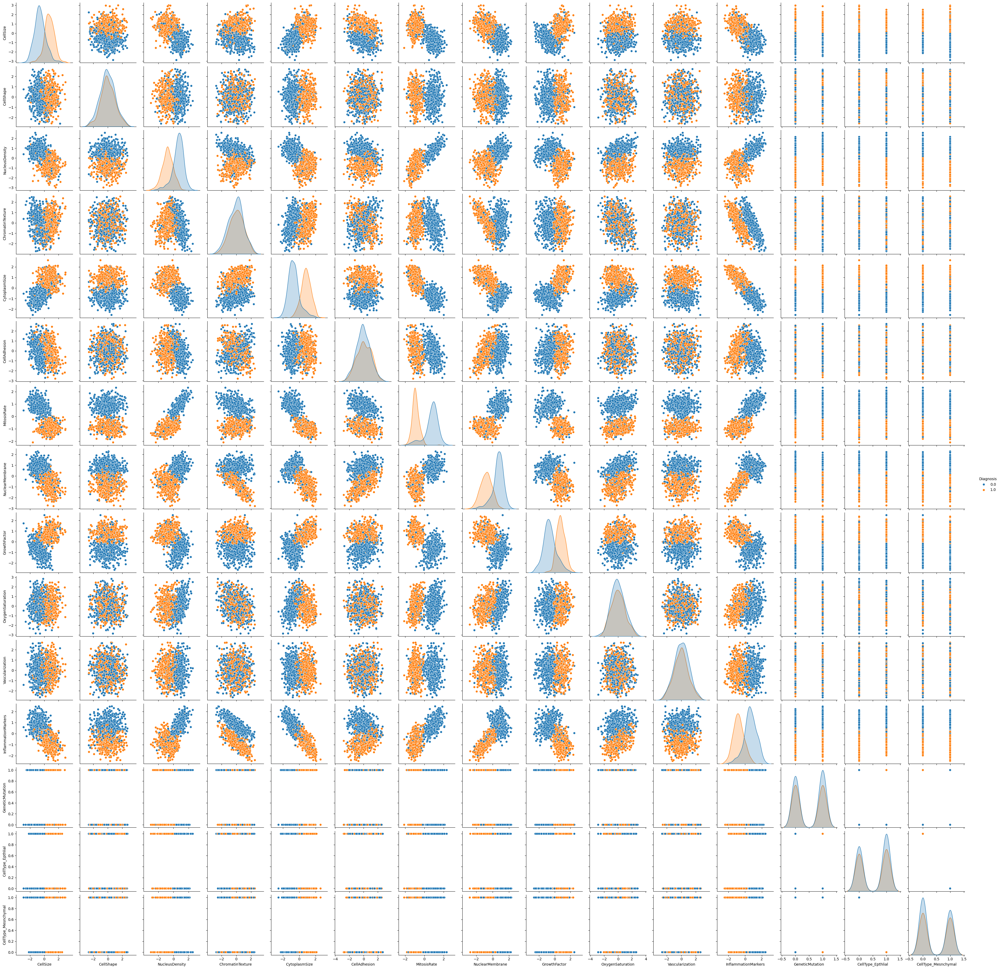

In [95]:
df_train, df_val = train_val_split(df)

df_train_nan = replace_question_marks_with_nan(df_train,'CellType')
df_train = knn_impute_all_optimized(df_train_nan) 
df_train = boxplot_outlier_removal(df_train,exclude=['Diagnosis','CellType','GeneticMutation'])
df_train = one_hot_encode_column(df_train,'CellType')
df_train = convert_to_binary(df_train,'GeneticMutation')
df_train, stats_train = normalize_columns(df_train, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train.to_csv('problema1/data/processed/train_cleaned_cell_diagnosis_dev.csv', index=False)

df_val = replace_question_marks_with_nan(df_val,'CellType')
df_val = knn_impute_all_optimized(df_val) 
df_val = boxplot_outlier_removal(df_val,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val = one_hot_encode_column(df_val,'CellType')
df_val = convert_to_binary(df_val,'GeneticMutation')
df_val, stats_val = normalize_columns(df_val, stats=stats_train, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val.to_csv('problema1/data/processed/val_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train, hue='Diagnosis')

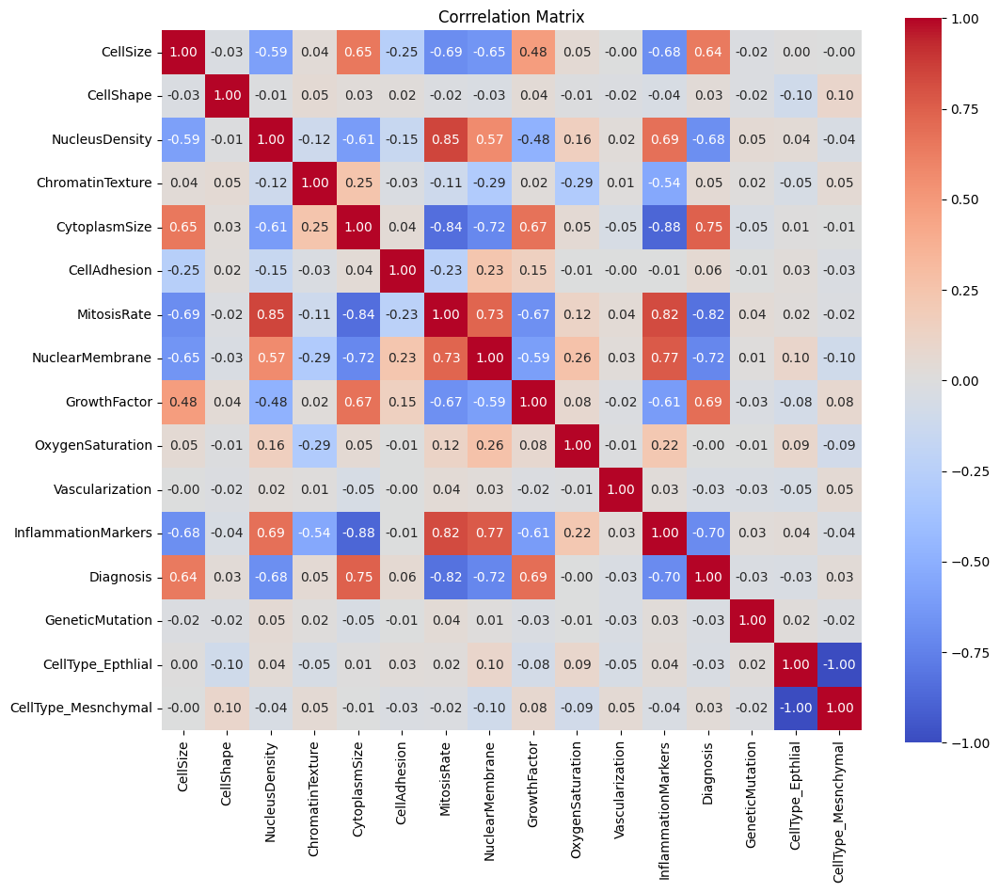

In [96]:
matrix = df_train.corr()

plt.figure(figsize=(12,10))
sn.heatmap(matrix,annot=True, fmt=".2f",cmap='coolwarm',square=True)
plt.title('Corrrelation Matrix')
plt.show()

Precision: 0.8625954198473282
Reacall: 1.0
Accuracy: 0.926829268292683
F-score: 0.9262295081967213


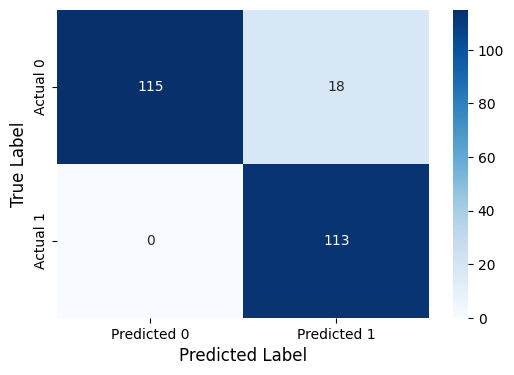

AUC-PR: 0.8661261913827042


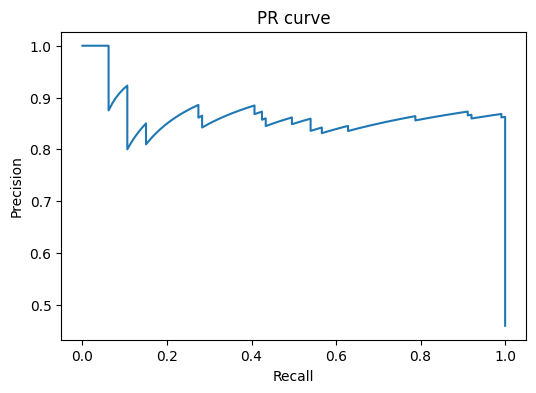

AUC-ROC: 0.9295362299554195


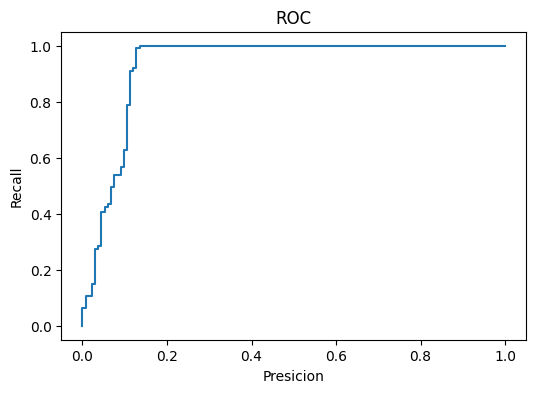

In [97]:
X_train = df_train.drop(columns=['Diagnosis'])
Y_train = df_train['Diagnosis']

X_val = df_val.drop(columns=['Diagnosis'])
Y_val = df_val['Diagnosis']

model = LogisticRegressionL2()
model.fit(X_train,Y_train)
Y_pred = model.predict(X_val)
Y_pred_prob = model.predict_proba(X_val)

precision_val = calculate_precision(Y_val, Y_pred)
print(f'Precision: {precision_val}')

recall_val = calculate_recall(Y_val, Y_pred)
print(f'Reacall: {recall_val}')

accuracy_val = calculate_accuracy(Y_val, Y_pred)
print(f'Accuracy: {accuracy_val}')

f_score_val = calculate_f1_score(Y_val,Y_pred)
print(f'F-score: {f_score_val}')

conf_matrix = calculate_confusion_matrix(Y_val,Y_pred)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label',fontsize=12)
plt.ylabel('True Label',fontsize=12)

# Display the plot
plt.show()

precision_vals, recall_vals, thresh = calculate_precision_recall_curve(Y_val,Y_pred_prob)
auc_PR_val = calculate_auc_pr(Y_val,Y_pred_prob) 
print(f'AUC-PR: {auc_PR_val}')

plt.figure(figsize=(6, 4))  # Set figure size
plt.plot(recall_vals, precision_vals)
# Add labels and title
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('PR curve')

# Display the plot
plt.show()

fpr_vals, tpr_vals = calculate_roc_curve(Y_val,Y_pred_prob)
auc_ROC_val = calculate_auc_roc(Y_val,Y_pred_prob)
print(f'AUC-ROC: {auc_ROC_val}')

plt.figure(figsize=(6, 4))  # Set figure size
plt.plot(fpr_vals,tpr_vals)
# Add labels and title
plt.xlabel('Presicion')
plt.ylabel('Recall')
plt.title('ROC')

# Display the plot
plt.show()



57 (30.81%) outliers removed
Precision: 0.9649122807017544
Reacall: 0.9821428571428571
Accuracy: 0.9765625
F-score: 0.9734513274336283


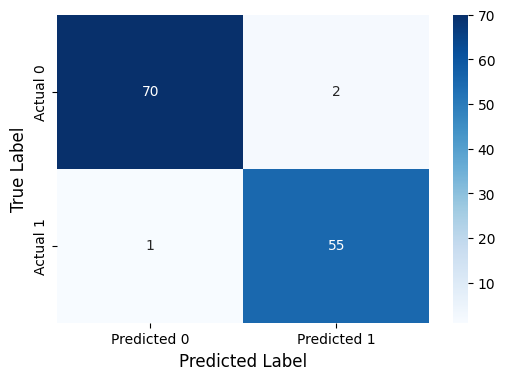

AUC-PR: 0.9695129340517197


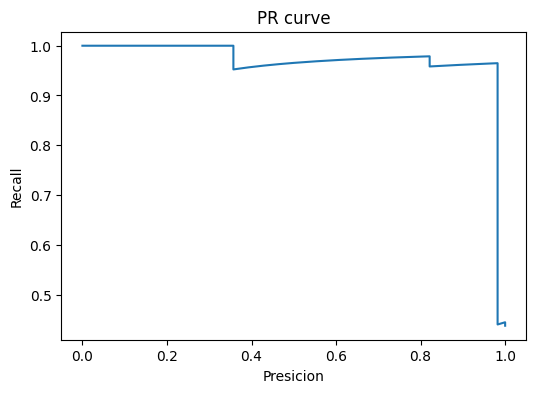

AUC-ROC: 0.9717261904761905


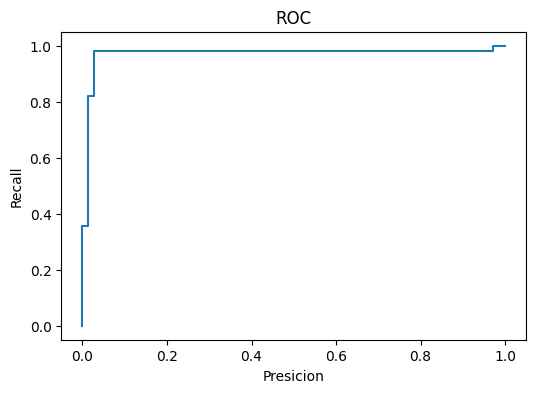

| Modelo     | Accuracy | Precision | Recall | F-Score | AUC-ROC | AUC-PR |
|------------|----------|-----------|--------|---------|---------|--------|
| Validation | 0.927    | 0.863     | 1.000  | 0.926   | 0.930   | 0.866  |
| Test       | 0.977    | 0.965     | 0.982  | 0.973   | 0.972   | 0.970  |


In [98]:
file_path = 'problema1/data/raw/cell_diagnosis_test.csv'
df_test = pd.read_csv(file_path)

df_test = replace_question_marks_with_nan(df_test,'CellType')
df_test = knn_impute_all_optimized(df_test) 
df_test = boxplot_outlier_removal(df_test,exclude=['Diagnosis','CellType','GeneticMutation'])
df_test = one_hot_encode_column(df_test,'CellType')
df_test = convert_to_binary(df_test,'GeneticMutation')
df_test, stats_test = normalize_columns(df_test, stats=stats_train, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])

X_test = df_test.drop(columns=['Diagnosis'])
Y_test = df_test['Diagnosis']

model = LogisticRegressionL2()
model.fit(X_train,Y_train)
Y_pred = model.predict(X_test)
Y_pred_prob = model.predict_proba(X_test)

precision_test = calculate_precision(Y_test, Y_pred)
print(f'Precision: {precision_test}')

recall_test = calculate_recall(Y_test, Y_pred)
print(f'Reacall: {recall_test}')

accuracy_test = calculate_accuracy(Y_test, Y_pred)
print(f'Accuracy: {accuracy_test}')

f_score_test = calculate_f1_score(Y_test,Y_pred)
print(f'F-score: {f_score_test}')

conf_matrix = calculate_confusion_matrix(Y_test,Y_pred)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label',fontsize=12)
plt.ylabel('True Label',fontsize=12)

# Display the plot
plt.show()
precision_vals, recall_vals, thresh = calculate_precision_recall_curve(Y_test,Y_pred_prob)
auc_PR_test = calculate_auc_pr(Y_test,Y_pred_prob) 
print(f'AUC-PR: {auc_PR_test}')

plt.figure(figsize=(6, 4))  # Set figure size
plt.plot(recall_vals, precision_vals)
# Add labels and title
plt.xlabel('Presicion')
plt.ylabel('Recall')
plt.title('PR curve')

# Display the plot
plt.show()

fpr_vals, tpr_vals = calculate_roc_curve(Y_test,Y_pred_prob)
auc_ROC_test = calculate_auc_roc(Y_test,Y_pred_prob)
print(f'AUC-ROC: {auc_ROC_test}')

plt.figure(figsize=(6, 4))  # Set figure size
plt.plot(fpr_vals,tpr_vals)
# Add labels and title
plt.xlabel('Presicion')
plt.ylabel('Recall')
plt.title('ROC')

# Display the plot
plt.show()

all_metrics = [[accuracy_val,accuracy_test], [precision_val,precision_test], [recall_val,recall_test], [f_score_val,f_score_test], [auc_ROC_val,auc_ROC_test], [auc_PR_val,auc_PR_test] ]

print_results_table_from_lists(all_metrics,exp_metrics=['Accuracy', 'Precision', 'Recall', 'F-Score', 'AUC-ROC', 'AUC-PR'], exp_models=['Validation', 'Test'])

## Imbalanced

231 (23.72%) outliers removed
69 (28.28%) outliers removed
Category counts:
Category 0: 562 samples
Category 1: 181 samples


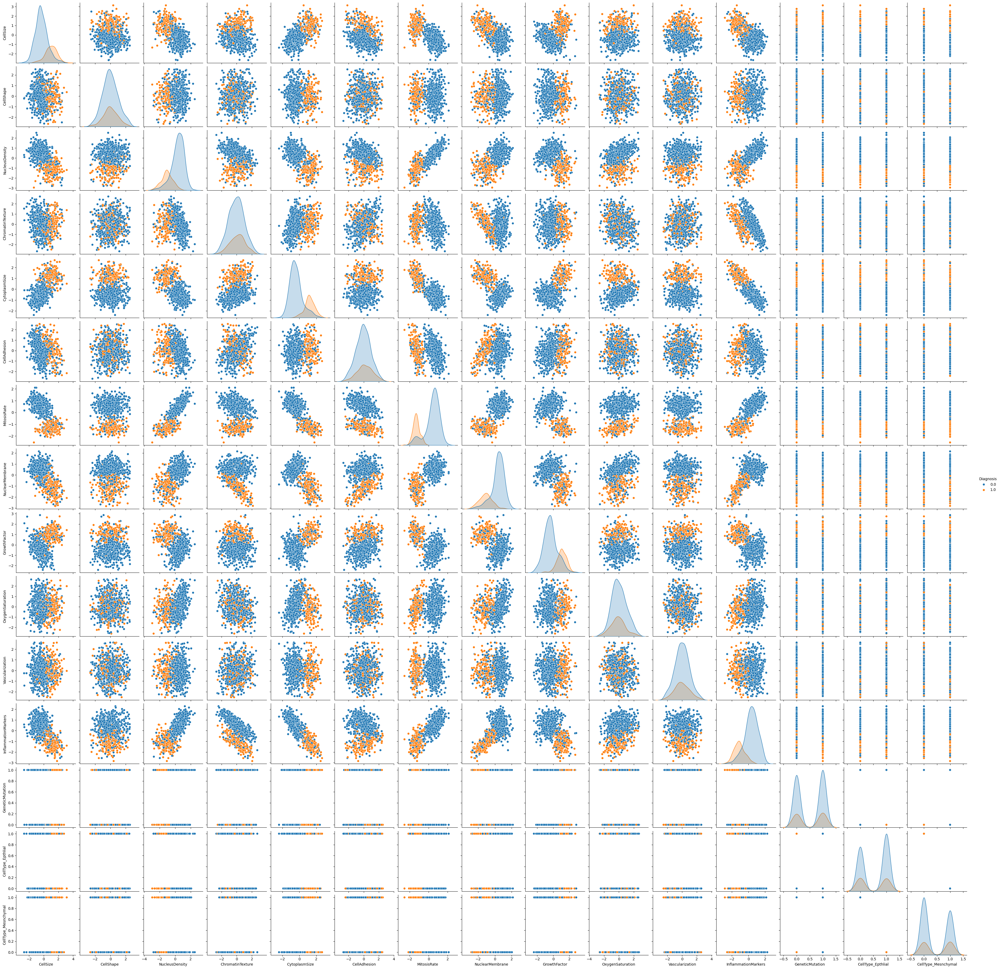

In [99]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb = pd.read_csv(file_path)

df_train_imb, df_val_imb = train_val_split(df_imb)

df_train_imb = replace_question_marks_with_nan(df_train_imb,'CellType')
df_train_imb = knn_impute_all_optimized(df_train_imb) 
df_train_imb = boxplot_outlier_removal(df_train_imb,exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb = one_hot_encode_column(df_train_imb,'CellType')
df_train_imb = convert_to_binary(df_train_imb,'GeneticMutation')
df_train_imb, stats_train_imb = normalize_columns(df_train_imb, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb.to_csv('problema1/data/processed/train_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb = replace_question_marks_with_nan(df_val_imb,'CellType')
df_val_imb = knn_impute_all_optimized(df_val_imb) 
df_val_imb = boxplot_outlier_removal(df_val_imb,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb = one_hot_encode_column(df_val_imb,'CellType')
df_val_imb = convert_to_binary(df_val_imb,'GeneticMutation')
df_val_imb, stats_val_imb = normalize_columns(df_val_imb, stats=stats_train_imb, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb.to_csv('problema1/data/processed/val_imbalanced_cleaned_cell_diagnosis_dev.csv', index=False)

count_dict = count_categories(df_train_imb,'Diagnosis')

print("Category counts:")
for category, count in count_dict.items():
    print(f"Category {category}: {count} samples")

sn.pairplot(df_train_imb, hue='Diagnosis')

Coefficients: [ 0.28092867  0.04621913 -0.28555433 -0.17725557  0.37973629  0.07279411
 -0.45727689 -0.34321103  0.42258588  0.05753338  0.05958682 -0.22678274
 -0.35821607 -0.56862494 -0.34252483]
Precision: 0.825
Reacall: 0.9166666666666666
Accuracy: 0.9428571428571428
F-score: 0.8684210526315789
AUC-PR: 0.7266994435204003
AUC-ROC: 0.9634292565947242


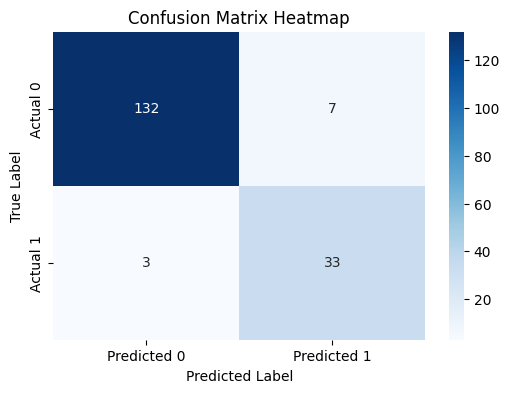

In [100]:
X_train_imb = df_train_imb.drop(columns=['Diagnosis'])
Y_train_imb = df_train_imb['Diagnosis']

X_val_imb = df_val_imb.drop(columns=['Diagnosis'])
Y_val_imb = df_val_imb['Diagnosis']

imbalanced_model = LogisticRegressionL2()
imbalanced_model.fit(X_train_imb,Y_train_imb)
imbalanced_model.print_coefficients()
Y_pred_imb = imbalanced_model.predict(X_val_imb)
Y_pred_prob_imb = imbalanced_model.predict_proba(X_val_imb)

precision_imb = calculate_precision(Y_val_imb, Y_pred_imb)
print(f'Precision: {precision_imb}')

recall_imb = calculate_recall(Y_val_imb, Y_pred_imb)
print(f'Reacall: {recall_imb}')

accuracy_imb = calculate_accuracy(Y_val_imb, Y_pred_imb)
print(f'Accuracy: {accuracy_imb}')

f_score_imb = calculate_f1_score(Y_val_imb,Y_pred_imb)
print(f'F-score: {f_score_imb}')

auc_PR_imb = calculate_auc_pr(Y_val_imb,Y_pred_prob_imb) 
print(f'AUC-PR: {auc_PR_imb}')

auc_ROC_imb = calculate_auc_roc(Y_val_imb,Y_pred_prob_imb)
print(f'AUC-ROC: {auc_ROC_imb}')

precision_vals_imb, recall_vals_imb, thresh = calculate_precision_recall_curve(Y_val_imb,Y_pred_prob_imb)

fpr_vals_imb, tpr_vals_imb = calculate_roc_curve(Y_val_imb,Y_pred_prob_imb)

conf_matrix_imb = calculate_confusion_matrix(Y_val_imb,Y_pred_imb)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix_imb, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap')

# Display the plot
plt.show()

## Undersampling

222 (22.79%) outliers removed
60 (24.59%) outliers removed


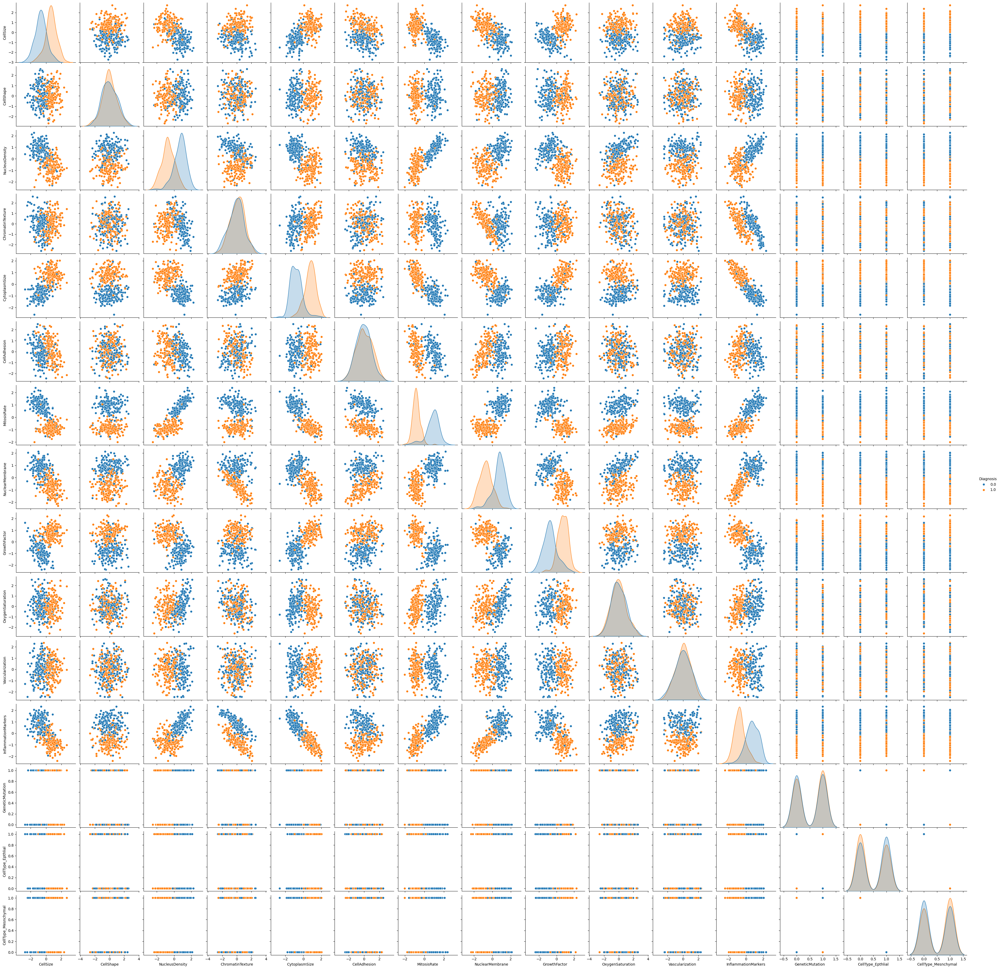

In [101]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb_under = pd.read_csv(file_path)

df_train_imb_under, df_val_imb_under = train_val_split(df_imb_under)

df_train_imb_under = replace_question_marks_with_nan(df_train_imb_under,'CellType')
df_train_imb_under = knn_impute_all_optimized(df_train_imb_under) 
df_train_imb_under = boxplot_outlier_removal(df_train_imb_under,exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb_under = undersample_data(df_train_imb_under,'Diagnosis')
df_train_imb_under = one_hot_encode_column(df_train_imb_under,'CellType')
df_train_imb_under = convert_to_binary(df_train_imb_under,'GeneticMutation')
df_train_imb_under, stats_train_imb_under = normalize_columns(df_train_imb_under, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb_under.to_csv('problema1/data/processed/train_under_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb_under = replace_question_marks_with_nan(df_val_imb_under,'CellType')
df_val_imb_under = knn_impute_all_optimized(df_val_imb_under) 
df_val_imb_under = boxplot_outlier_removal(df_val_imb_under,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb_under = one_hot_encode_column(df_val_imb_under,'CellType')
df_val_imb_under = convert_to_binary(df_val_imb_under,'GeneticMutation')
df_val_imb_under, stats_val_imb_under = normalize_columns(df_val_imb_under, stats=stats_train_imb_under, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb_under.to_csv('problema1/data/processed/val_under_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train_imb_under, hue='Diagnosis')

Coefficients: [ 0.46247909  0.02608966 -0.53521356 -0.19140627  0.56305164 -0.01601557
 -0.6638998  -0.56859904  0.60129974  0.27428256 -0.04979789 -0.35745087
  0.02742934 -0.01365468 -0.02635405]
Precision: 0.746031746031746
Recall: 1.0
Accuracy: 0.9130434782608695
F-score: 0.8545454545454546
AUC-PR: 0.7302346710609562
AUC-ROC: 0.9369467308588291


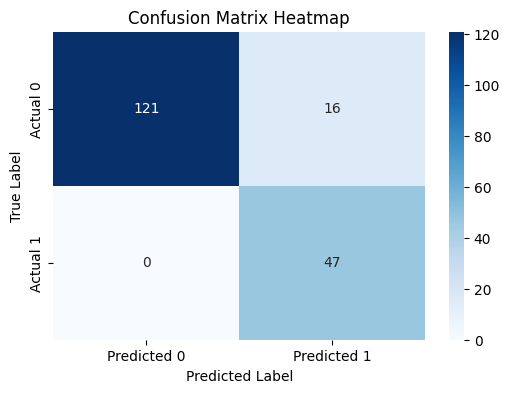

In [102]:
X_train_imb_under = df_train_imb_under.drop(columns=['Diagnosis'])
Y_train_imb_under = df_train_imb_under['Diagnosis']

X_val_imb_under = df_val_imb_under.drop(columns=['Diagnosis'])
Y_val_imb_under = df_val_imb_under['Diagnosis']

imbalanced_model_under = LogisticRegressionL2()
imbalanced_model_under.fit(X_train_imb_under,Y_train_imb_under)
imbalanced_model_under.print_coefficients()
Y_pred_imb_under = imbalanced_model_under.predict(X_val_imb_under)
Y_pred_prob_imb_under = imbalanced_model_under.predict_proba(X_val_imb_under)

precision_imb_under = calculate_precision(Y_val_imb_under, Y_pred_imb_under)
print(f'Precision: {precision_imb_under}')

recall_imb_under = calculate_recall(Y_val_imb_under, Y_pred_imb_under)
print(f'Recall: {recall_imb_under}')

accuracy_imb_under = calculate_accuracy(Y_val_imb_under, Y_pred_imb_under)
print(f'Accuracy: {accuracy_imb_under}')

f_score_imb_under = calculate_f1_score(Y_val_imb_under,Y_pred_imb_under)
print(f'F-score: {f_score_imb_under}')

auc_PR_imb_under = calculate_auc_pr(Y_val_imb_under,Y_pred_prob_imb_under) 
print(f'AUC-PR: {auc_PR_imb_under}')

auc_ROC_imb_under = calculate_auc_roc(Y_val_imb_under,Y_pred_prob_imb_under)
print(f'AUC-ROC: {auc_ROC_imb_under}')

precision_vals_imb_under, recall_vals_imb_under, thresh = calculate_precision_recall_curve(Y_val_imb_under,Y_pred_prob_imb_under)

fpr_vals_imb_under, tpr_vals_imb_under = calculate_roc_curve(Y_val_imb_under,Y_pred_prob_imb_under)

conf_matrix_imb_under = calculate_confusion_matrix(Y_val_imb_under,Y_pred_imb_under)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix_imb_under, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap')

# Display the plot
plt.show()

## Oversampling duplicate

236 (24.23%) outliers removed
58 (23.77%) outliers removed


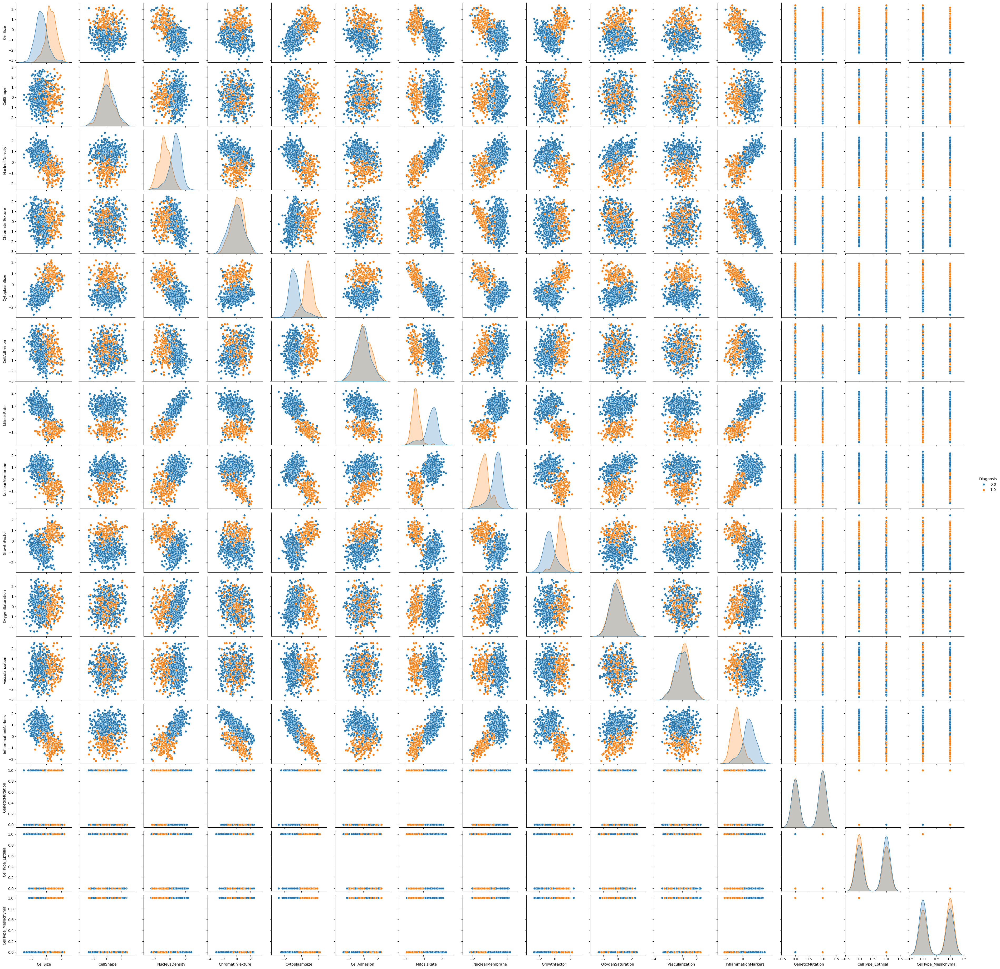

In [103]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb_over_dup = pd.read_csv(file_path)

df_train_imb_over_dup, df_val_imb_over_dup = train_val_split(df_imb_over_dup)

df_train_imb_over_dup = replace_question_marks_with_nan(df_train_imb_over_dup,'CellType')
df_train_imb_over_dup = knn_impute_all_optimized(df_train_imb_over_dup) 
df_train_imb_over_dup = boxplot_outlier_removal(df_train_imb_over_dup,exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb_over_dup = oversample_data_dup(df_train_imb_over_dup,'Diagnosis')
df_train_imb_over_dup = one_hot_encode_column(df_train_imb_over_dup,'CellType')
df_train_imb_over_dup = convert_to_binary(df_train_imb_over_dup,'GeneticMutation')
df_train_imb_over_dup, stats_train_imb_over_dup = normalize_columns(df_train_imb_over_dup, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb_over_dup.to_csv('problema1/data/processed/train_duplicate_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb_over_dup = replace_question_marks_with_nan(df_val_imb_over_dup,'CellType')
df_val_imb_over_dup = knn_impute_all_optimized(df_val_imb_over_dup) 
df_val_imb_over_dup = boxplot_outlier_removal(df_val_imb_over_dup,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb_over_dup = one_hot_encode_column(df_val_imb_over_dup,'CellType')
df_val_imb_over_dup = convert_to_binary(df_val_imb_over_dup,'GeneticMutation')
df_val_imb_over_dup, stats_val_imb_over_dup = normalize_columns(df_val_imb_over_dup, stats=stats_train_imb_over_dup, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb_over_dup.to_csv('problema1/data/processed/val_duplicate_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train_imb_over_dup, hue='Diagnosis')

Coefficients: [ 0.37812048  0.00897148 -0.43026206 -0.05929809  0.51195009  0.09115599
 -0.62607276 -0.55505362  0.51558728  0.1589889   0.03369773 -0.37572184
 -0.02309802 -0.10474636  0.04584438]
Precision: 0.7681159420289855
Recall: 0.9636363636363636
Accuracy: 0.9032258064516129
F-score: 0.8548387096774193
AUC-PR: 0.8143794164185576
AUC-ROC: 0.9471200555170021


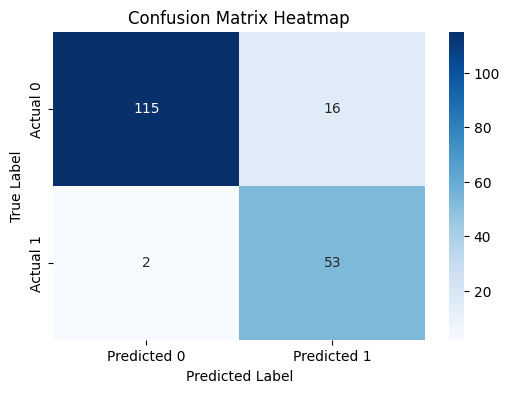

In [104]:
X_train_imb_over_dup = df_train_imb_over_dup.drop(columns=['Diagnosis'])
Y_train_imb_over_dup = df_train_imb_over_dup['Diagnosis']

X_val_imb_over_dup = df_val_imb_over_dup.drop(columns=['Diagnosis'])
Y_val_imb_over_dup = df_val_imb_over_dup['Diagnosis']

imb_model_over_dup = LogisticRegressionL2()
imb_model_over_dup.fit(X_train_imb_over_dup,Y_train_imb_over_dup)
imb_model_over_dup.print_coefficients()
Y_pred_imb_over_dup = imb_model_over_dup.predict(X_val_imb_over_dup)
Y_pred_prob_imb_over_dup = imb_model_over_dup.predict_proba(X_val_imb_over_dup)

precision_imb_over_dup = calculate_precision(Y_val_imb_over_dup, Y_pred_imb_over_dup)
print(f'Precision: {precision_imb_over_dup}')

recall_imb_over_dup = calculate_recall(Y_val_imb_over_dup, Y_pred_imb_over_dup)
print(f'Recall: {recall_imb_over_dup}')

accuracy_imb_over_dup = calculate_accuracy(Y_val_imb_over_dup, Y_pred_imb_over_dup)
print(f'Accuracy: {accuracy_imb_over_dup}')

f_score_imb_over_dup = calculate_f1_score(Y_val_imb_over_dup, Y_pred_imb_over_dup)
print(f'F-score: {f_score_imb_over_dup}')

auc_PR_imb_over_dup = calculate_auc_pr(Y_val_imb_over_dup, Y_pred_prob_imb_over_dup) 
print(f'AUC-PR: {auc_PR_imb_over_dup}')

auc_ROC_imb_over_dup = calculate_auc_roc(Y_val_imb_over_dup, Y_pred_prob_imb_over_dup)
print(f'AUC-ROC: {auc_ROC_imb_over_dup}')

precision_vals_imb_over_dup, recall_vals_imb_over_dup, thresh = calculate_precision_recall_curve(Y_val_imb_over_dup,Y_pred_prob_imb_over_dup)

fpr_vals_imb_over_dup, tpr_vals_imb_over_dup = calculate_roc_curve(Y_val_imb_over_dup,Y_pred_prob_imb_over_dup)

conf_matrix_imb_over_dup = calculate_confusion_matrix(Y_val_imb_over_dup,Y_pred_imb_over_dup)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix_imb_over_dup, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap')

# Display the plot
plt.show()

## Oversampling SMOTE

253 (25.98%) outliers removed
54 (22.13%) outliers removed


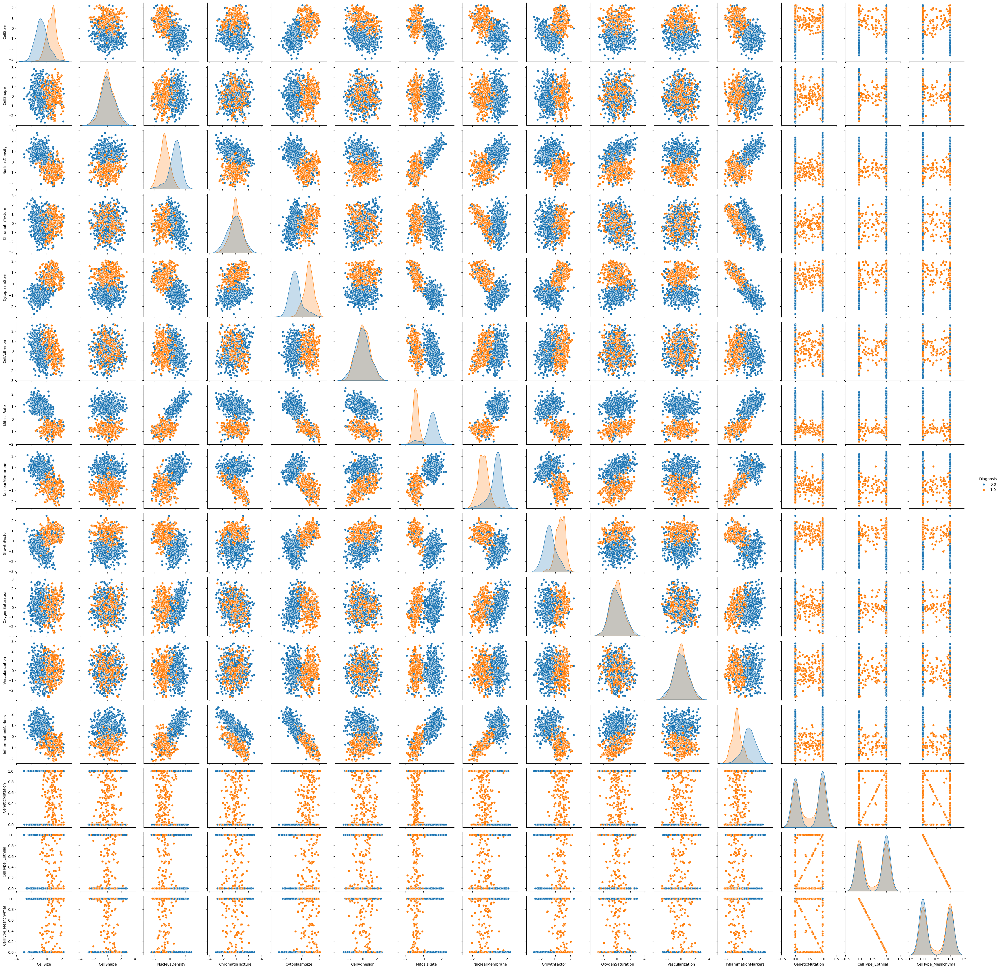

In [105]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb_over_SMOTE = pd.read_csv(file_path)

df_train_imb_over_SMOTE, df_val_imb_over_SMOTE = train_val_split(df_imb_over_SMOTE)

df_train_imb_over_SMOTE = replace_question_marks_with_nan(df_train_imb_over_SMOTE,'CellType')
df_train_imb_over_SMOTE = knn_impute_all_optimized(df_train_imb_over_SMOTE) 
df_train_imb_over_SMOTE = boxplot_outlier_removal(df_train_imb_over_SMOTE, exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb_over_SMOTE = one_hot_encode_column(df_train_imb_over_SMOTE,'CellType')
df_train_imb_over_SMOTE = convert_to_binary(df_train_imb_over_SMOTE,'GeneticMutation')
df_train_imb_over_SMOTE = oversample_smote(df_train_imb_over_SMOTE,'Diagnosis')
df_train_imb_over_SMOTE, stats_train_imb_over_SMOTE = normalize_columns(df_train_imb_over_SMOTE, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb_over_SMOTE.to_csv('problema1/data/processed/train_SMOTE_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb_over_SMOTE = replace_question_marks_with_nan(df_val_imb_over_SMOTE,'CellType')
df_val_imb_over_SMOTE = knn_impute_all_optimized(df_val_imb_over_SMOTE) 
df_val_imb_over_SMOTE = boxplot_outlier_removal(df_val_imb_over_SMOTE,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb_over_SMOTE = one_hot_encode_column(df_val_imb_over_SMOTE,'CellType')
df_val_imb_over_SMOTE = convert_to_binary(df_val_imb_over_SMOTE,'GeneticMutation')
df_val_imb_over_SMOTE, stats_val_imb_over_SMOTE = normalize_columns(df_val_imb_over_SMOTE, stats=stats_train_imb_over_SMOTE, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb_over_SMOTE.to_csv('problema1/data/processed/val_SMOTE_cleaned_cell_diagnosis_dev.csv', index=False)

sn.pairplot(df_train_imb_over_SMOTE, hue='Diagnosis')

Coefficients: [ 0.42399978  0.00904031 -0.46924955 -0.12613761  0.48399931  0.02495198
 -0.61836514 -0.5580849   0.50616077  0.16704514  0.01985278 -0.38359204
 -0.00851464 -0.07365552 -0.01815833]
Precision: 0.7704918032786885
Recall: 0.9791666666666666
Accuracy: 0.9210526315789473
F-score: 0.8623853211009173
AUC-PR: 0.7658628310625821
AUC-ROC: 0.9479166666666667


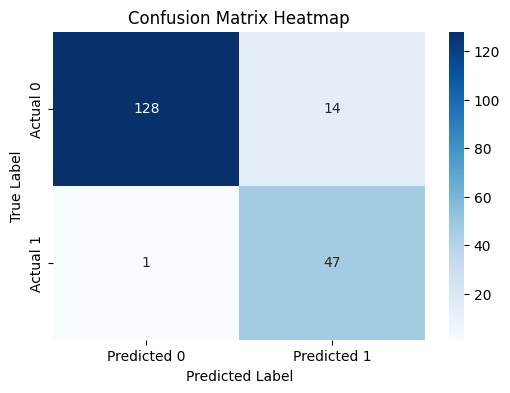

In [106]:
X_train_imb_over_SMOTE = df_train_imb_over_SMOTE.drop(columns=['Diagnosis'])
Y_train_imb_over_SMOTE = df_train_imb_over_SMOTE['Diagnosis']

X_val_imb_over_SMOTE = df_val_imb_over_SMOTE.drop(columns=['Diagnosis'])
Y_val_imb_over_SMOTE = df_val_imb_over_SMOTE['Diagnosis']

imb_model_over_SMOTE = LogisticRegressionL2()
imb_model_over_SMOTE.fit(X_train_imb_over_SMOTE, Y_train_imb_over_SMOTE)
imb_model_over_SMOTE.print_coefficients()
Y_pred_imb_over_SMOTE = imb_model_over_SMOTE.predict(X_val_imb_over_SMOTE)
Y_pred_prob_imb_over_SMOTE = imb_model_over_SMOTE.predict_proba(X_val_imb_over_SMOTE)

precision_imb_over_SMOTE = calculate_precision(Y_val_imb_over_SMOTE, Y_pred_imb_over_SMOTE)
print(f'Precision: {precision_imb_over_SMOTE}')

recall_imb_over_SMOTE = calculate_recall(Y_val_imb_over_SMOTE, Y_pred_imb_over_SMOTE)
print(f'Recall: {recall_imb_over_SMOTE}')

accuracy_imb_over_SMOTE = calculate_accuracy(Y_val_imb_over_SMOTE, Y_pred_imb_over_SMOTE)
print(f'Accuracy: {accuracy_imb_over_SMOTE}')

f_score_imb_over_SMOTE = calculate_f1_score(Y_val_imb_over_SMOTE, Y_pred_imb_over_SMOTE)
print(f'F-score: {f_score_imb_over_SMOTE}')

auc_PR_imb_over_SMOTE = calculate_auc_pr(Y_val_imb_over_SMOTE, Y_pred_prob_imb_over_SMOTE) 
print(f'AUC-PR: {auc_PR_imb_over_SMOTE}')

auc_ROC_imb_over_SMOTE = calculate_auc_roc(Y_val_imb_over_SMOTE, Y_pred_prob_imb_over_SMOTE)
print(f'AUC-ROC: {auc_ROC_imb_over_SMOTE}')

precision_vals_imb_over_SMOTE, recall_vals_imb_over_SMOTE, thresh = calculate_precision_recall_curve(Y_val_imb_over_SMOTE,Y_pred_prob_imb_over_SMOTE)

fpr_vals_imb_over_SMOTE, tpr_vals_imb_over_SMOTE = calculate_roc_curve(Y_val_imb_over_SMOTE,Y_pred_prob_imb_over_SMOTE)

conf_matrix_imb_over_SMOTE = calculate_confusion_matrix(Y_val_imb_over_SMOTE,Y_pred_imb_over_SMOTE)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix_imb_over_SMOTE, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap')

# Display the plot
plt.show()

## Cost re-weighting

In [107]:
file_path = 'problema1/data/raw/cell_diagnosis_dev_imbalanced.csv'
df_imb_cost = pd.read_csv(file_path)

df_train_imb_cost, df_val_imb_cost = train_val_split(df_imb_cost)

df_train_imb_cost = replace_question_marks_with_nan(df_train_imb_cost,'CellType')
df_train_imb_cost = knn_impute_all_optimized(df_train_imb_cost) 
df_train_imb_cost = boxplot_outlier_removal(df_train_imb_cost, exclude=['Diagnosis','CellType','GeneticMutation'])
df_train_imb_cost = one_hot_encode_column(df_train_imb_cost,'CellType')
df_train_imb_cost = convert_to_binary(df_train_imb_cost,'GeneticMutation')
df_train_imb_cost, stats_train_imb_cost = normalize_columns(df_train_imb_cost, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_train_imb_cost.to_csv('problema1/data/processed/train_COST_cleaned_cell_diagnosis_dev.csv', index=False)

df_val_imb_cost = replace_question_marks_with_nan(df_val_imb_cost,'CellType')
df_val_imb_cost = knn_impute_all_optimized(df_val_imb_cost) 
df_val_imb_cost = boxplot_outlier_removal(df_val_imb_cost,exclude=['Diagnosis','CellType','GeneticMutation'])
df_val_imb_cost = one_hot_encode_column(df_val_imb_cost,'CellType')
df_val_imb_cost = convert_to_binary(df_val_imb_cost,'GeneticMutation')
df_val_imb_cost, stats_val_imb_cost = normalize_columns(df_val_imb_cost, stats=stats_train_imb_cost, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_val_imb_cost.to_csv('problema1/data/processed/val_COST_cleaned_cell_diagnosis_dev.csv', index=False)

234 (24.02%) outliers removed
59 (24.18%) outliers removed


Coefficients: [ 0.24569442 -0.06744575 -0.26787918 -0.13984798  0.43597149  0.10783225
 -0.53087578 -0.46393442  0.45707431  0.15151328 -0.00674352 -0.28167686
 -0.30932165 -0.45970449 -0.34659487]
Precision: 0.8367346938775511
Recall: 0.9111111111111111
Accuracy: 0.9351351351351351
F-score: 0.8723404255319148
AUC-PR: 0.8039182610257958
AUC-ROC: 0.9696825396825397


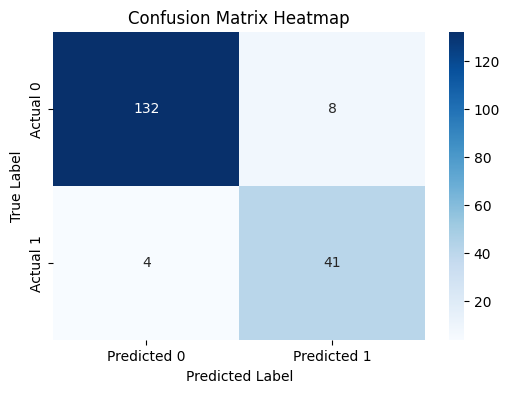

In [108]:
X_train_imb_cost = df_train_imb_cost.drop(columns=['Diagnosis'])
Y_train_imb_cost = df_train_imb_cost['Diagnosis']

X_val_imb_cost = df_val_imb_cost.drop(columns=['Diagnosis'])
Y_val_imb_cost = df_val_imb_cost['Diagnosis']

imb_model_cost = LogisticRegressionL2_cost(cost_fn=2.0)
imb_model_cost.fit(X_train_imb_cost, Y_train_imb_cost)
imb_model_cost.print_coefficients()
Y_pred_imb_cost = imb_model_cost.predict(X_val_imb_cost)
Y_pred_prob_imb_cost = imb_model_cost.predict_proba(X_val_imb_cost)

precision_imb_cost = calculate_precision(Y_val_imb_cost, Y_pred_imb_cost)
print(f'Precision: {precision_imb_cost}')

recall_imb_cost = calculate_recall(Y_val_imb_cost, Y_pred_imb_cost)
print(f'Recall: {recall_imb_cost}')

accuracy_imb_cost = calculate_accuracy(Y_val_imb_cost, Y_pred_imb_cost)
print(f'Accuracy: {accuracy_imb_cost}')

f_score_imb_cost = calculate_f1_score(Y_val_imb_cost, Y_pred_imb_cost)
print(f'F-score: {f_score_imb_cost}')

auc_PR_imb_cost = calculate_auc_pr(Y_val_imb_cost, Y_pred_prob_imb_cost) 
print(f'AUC-PR: {auc_PR_imb_cost}')

auc_ROC_imb_cost = calculate_auc_roc(Y_val_imb_cost, Y_pred_prob_imb_cost)
print(f'AUC-ROC: {auc_ROC_imb_cost}')

precision_vals_imb_cost, recall_vals_imb_cost, thresh = calculate_precision_recall_curve(Y_val_imb_cost,Y_pred_prob_imb_cost)

fpr_vals_imb_cost, tpr_vals_imb_cost = calculate_roc_curve(Y_val_imb_cost,Y_pred_prob_imb_cost)

conf_matrix_imb_cost = calculate_confusion_matrix(Y_val_imb_cost,Y_pred_imb_cost)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix_imb_cost, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 0', 'Predicted 1'], 
            yticklabels=['Actual 0', 'Actual 1'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap')

# Display the plot
plt.show()

| Modelo                 | Accuracy | Precision | Recall | F-Score | AUC-ROC | AUC-PR |
|------------------------|----------|-----------|--------|---------|---------|--------|
| Sin rebalanceo         | 0.943    | 0.825     | 0.917  | 0.868   | 0.963   | 0.727  |
| Undersampling          | 0.913    | 0.746     | 1.000  | 0.855   | 0.937   | 0.730  |
| Oversampling duplicate | 0.903    | 0.768     | 0.964  | 0.855   | 0.947   | 0.814  |
| Oversampling SMOTE     | 0.921    | 0.770     | 0.979  | 0.862   | 0.948   | 0.766  |
| Cost re-weighting      | 0.935    | 0.837     | 0.911  | 0.872   | 0.970   | 0.804  |


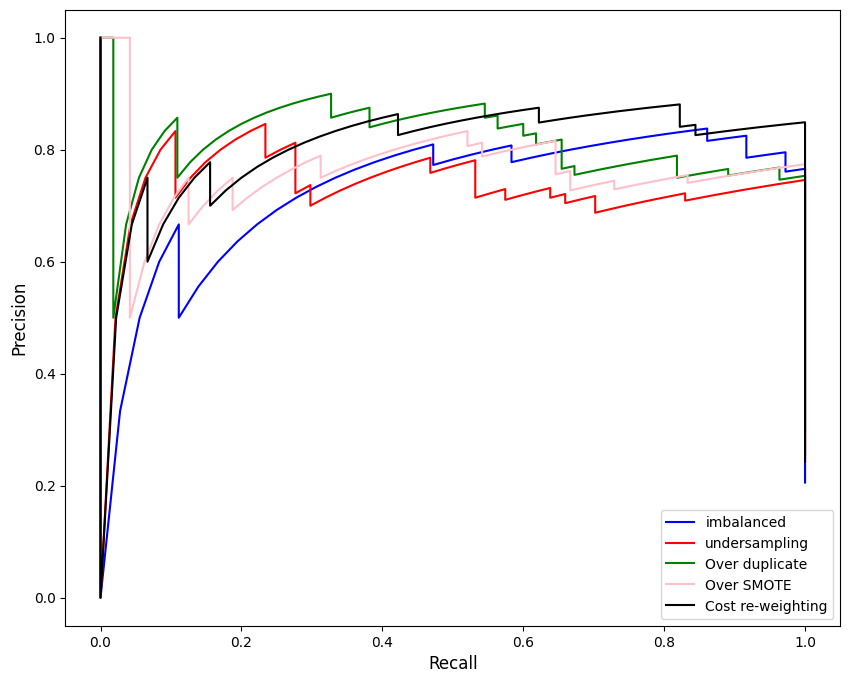

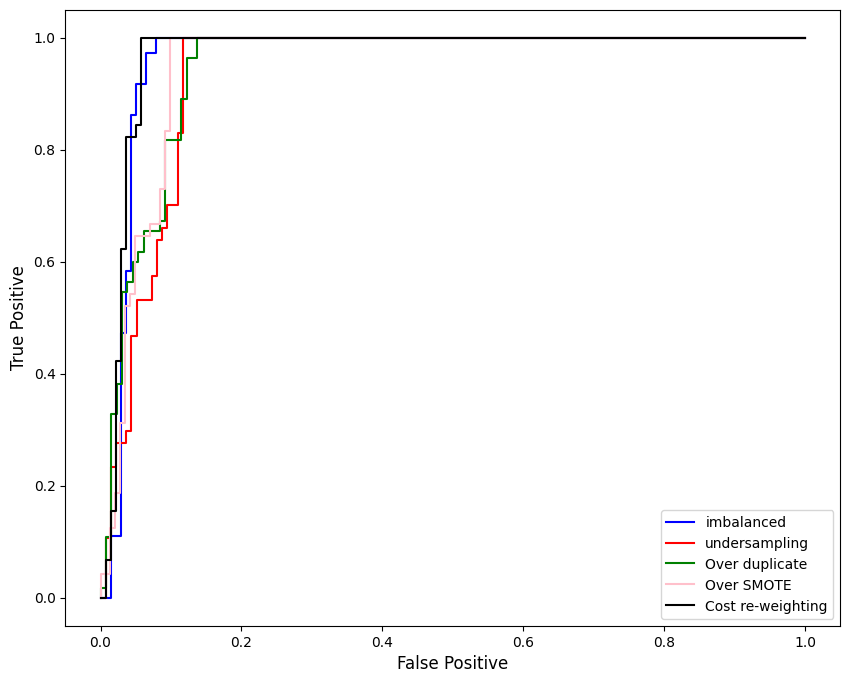

In [109]:
all_precisions = [precision_imb, precision_imb_under, precision_imb_over_dup, precision_imb_over_SMOTE, precision_imb_cost]
all_accuracys = [accuracy_imb, accuracy_imb_under, accuracy_imb_over_dup, accuracy_imb_over_SMOTE, accuracy_imb_cost]
all_recalls = [recall_imb, recall_imb_under, recall_imb_over_dup, recall_imb_over_SMOTE, recall_imb_cost]
all_f_scores = [f_score_imb, f_score_imb_under, f_score_imb_over_dup, f_score_imb_over_SMOTE, f_score_imb_cost]
all_auc_PRs = [auc_PR_imb, auc_PR_imb_under, auc_PR_imb_over_dup, auc_PR_imb_over_SMOTE, auc_PR_imb_cost]
all_auc_ROCs = [auc_ROC_imb, auc_ROC_imb_under, auc_ROC_imb_over_dup, auc_ROC_imb_over_SMOTE, auc_ROC_imb_cost]

all_metrics = [all_accuracys, all_precisions, all_recalls, all_f_scores, all_auc_ROCs, all_auc_PRs]
print_results_table_from_lists(all_metrics, exp_metrics=['Accuracy', 'Precision', 'Recall', 'F-Score', 'AUC-ROC', 'AUC-PR'], exp_models=['Sin rebalanceo', 'Undersampling', 'Oversampling duplicate', 'Oversampling SMOTE', 'Cost re-weighting'])

plt.figure(figsize=(10, 8))
plt.plot(recall_vals_imb, precision_vals_imb, label='imbalanced', color='blue', )
plt.plot(recall_vals_imb_under, precision_vals_imb_under, label='undersampling', color='red', )
plt.plot(recall_vals_imb_over_dup, precision_vals_imb_over_dup, label='Over duplicate', color='green', )
plt.plot(recall_vals_imb_over_SMOTE, precision_vals_imb_over_SMOTE, label='Over SMOTE', color='pink', )
plt.plot(recall_vals_imb_cost, precision_vals_imb_cost, label='Cost re-weighting', color='black', )
# plt.title('All PRs')
plt.xlabel('Recall',fontsize=12)
plt.ylabel('Precision',fontsize=12)
plt.legend()
plt.show()

plt.figure(figsize=(10, 8))
plt.plot(fpr_vals_imb, tpr_vals_imb, label='imbalanced', color='blue', )
plt.plot(fpr_vals_imb_under, tpr_vals_imb_under, label='undersampling', color='red', )
plt.plot(fpr_vals_imb_over_dup, tpr_vals_imb_over_dup, label='Over duplicate', color='green', )
plt.plot(fpr_vals_imb_over_SMOTE, tpr_vals_imb_over_SMOTE, label='Over SMOTE', color='pink', )
plt.plot(fpr_vals_imb_cost, tpr_vals_imb_cost, label='Cost re-weighting', color='black', )
# plt.title('All ROCs')
plt.xlabel('False Positive',fontsize=12)
plt.ylabel('True Positive',fontsize=12)
plt.legend()
plt.show()

## Metrics with Test set

33 (24.26%) outliers removed
| Modelo                 | Accuracy | Precision | Recall | F-Score | AUC-ROC | AUC-PR |
|------------------------|----------|-----------|--------|---------|---------|--------|
| Sin rebalanceo         | 0.942    | 0.833     | 0.909  | 0.870   | 0.930   | 0.825  |
| Undersampling          | 0.951    | 0.840     | 0.955  | 0.894   | 0.953   | 0.888  |
| Oversampling duplicate | 0.951    | 0.840     | 0.955  | 0.894   | 0.953   | 0.888  |
| Oversampling SMOTE     | 0.951    | 0.840     | 0.955  | 0.894   | 0.953   | 0.888  |
| Cost re-weighting      | 0.942    | 0.833     | 0.909  | 0.870   | 0.930   | 0.825  |


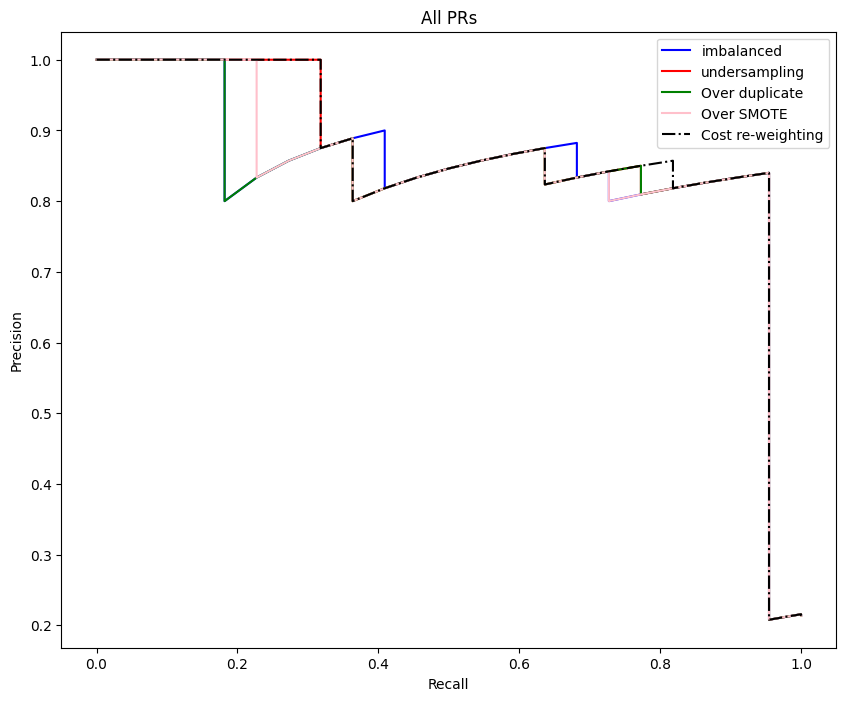

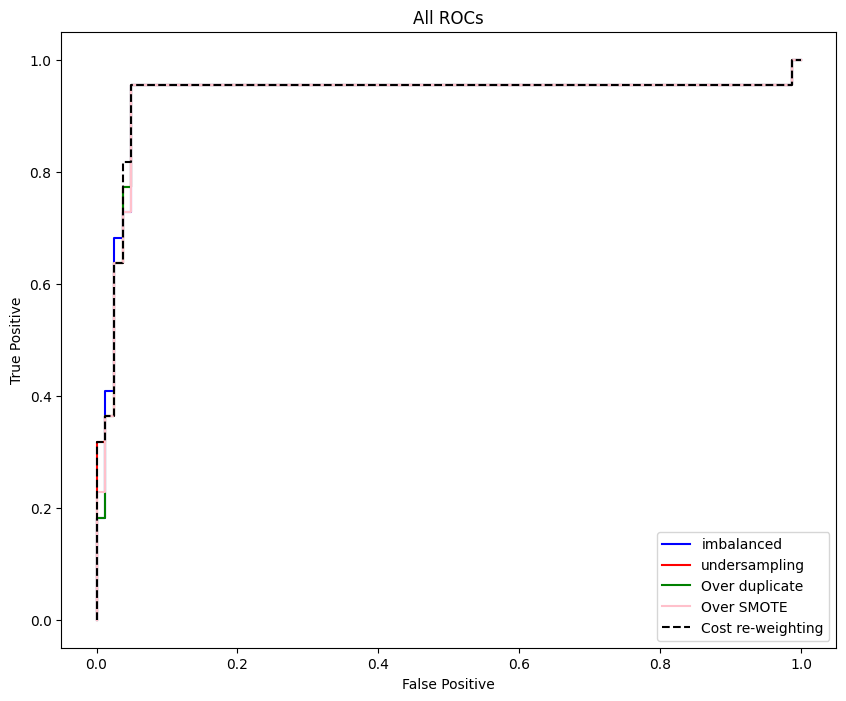

In [110]:
file_path = 'problema1/data/raw/cell_diagnosis_test_imbalanced.csv'
df_test = pd.read_csv(file_path)

df_test = replace_question_marks_with_nan(df_test,'CellType')
df_test = knn_impute_all_optimized(df_test) 
df_test = boxplot_outlier_removal(df_test,q1=0.05,q3=0.95,exclude=['Diagnosis','CellType','GeneticMutation'])
df_test = one_hot_encode_column(df_test,'CellType')
df_test = convert_to_binary(df_test,'GeneticMutation')

df_test_imb, stats_test_imb = normalize_columns(df_test, stats=stats_train_imb, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_test_imb_under, stats_test_imb_under = normalize_columns(df_test, stats=stats_train_imb_under, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_test_imb_over_dup, stats_test_imb_over_dup = normalize_columns(df_test, stats=stats_train_imb_over_dup, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_test_imb_over_SMOTE, stats_test_imb_over_SMOTE = normalize_columns(df_test, stats=stats_train_imb_over_SMOTE, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])
df_test_imb_cost, stats_test_imb_cost = normalize_columns(df_test, stats=stats_train_imb_cost, exclude_cols=['Diagnosis','GeneticMutation','CellType_Epthlial','CellType_Mesnchymal'])



X_test_imb = df_test_imb.drop(columns=['Diagnosis'])
Y_test_imb = df_test_imb['Diagnosis']

X_test_imb_under = df_test_imb_under.drop(columns=['Diagnosis'])
Y_test_imb_under = df_test_imb_under['Diagnosis']

X_test_imb_over_dup = df_test_imb_over_dup.drop(columns=['Diagnosis'])
Y_test_imb_over_dup = df_test_imb_over_dup['Diagnosis']

X_test_imb_over_SMOTE = df_test_imb_over_SMOTE.drop(columns=['Diagnosis'])
Y_test_imb_over_SMOTE = df_test_imb_over_SMOTE['Diagnosis']

X_test_imb_cost = df_test_imb_cost.drop(columns=['Diagnosis'])
Y_test_imb_cost = df_test_imb_cost['Diagnosis']


Y_pred_imb_test = imbalanced_model.predict(X_test_imb)
Y_pred_prob_imb_test = imbalanced_model.predict_proba(X_test_imb)

Y_pred_imb_test_under = imbalanced_model_under.predict(X_test_imb_under)
Y_pred_prob_imb_test_under = imbalanced_model_under.predict_proba(X_test_imb_under)

Y_pred_imb_test_over_dup = imb_model_over_dup.predict(X_test_imb_over_dup)
Y_pred_prob_imb_test_over_dup = imb_model_over_dup.predict_proba(X_test_imb_over_dup)

Y_pred_imb_test_over_SMOTE = imb_model_over_SMOTE.predict(X_test_imb_over_SMOTE)
Y_pred_prob_imb_test_over_SMOTE = imb_model_over_SMOTE.predict_proba(X_test_imb_over_SMOTE)

Y_pred_imb_test_cost = imb_model_cost.predict(X_test_imb_cost)
Y_pred_prob_imb_test_cost = imb_model_cost.predict_proba(X_test_imb_cost)


precision_imb_test = calculate_precision(Y_test_imb, Y_pred_imb_test)
precision_imb_test_under = calculate_precision(Y_test_imb_under, Y_pred_imb_test_under)
precision_imb_test_over_dup = calculate_precision(Y_test_imb_over_dup, Y_pred_imb_test_over_dup)
precision_imb_test_over_SMOTE = calculate_precision(Y_test_imb_over_SMOTE, Y_pred_imb_test_over_SMOTE)
precision_imb_test_cost = calculate_precision(Y_test_imb_cost, Y_pred_imb_test_cost)

accuracy_imb_test = calculate_accuracy(Y_test_imb, Y_pred_imb_test)
accuracy_imb_test_under = calculate_accuracy(Y_test_imb_under, Y_pred_imb_test_under)
accuracy_imb_test_over_dup = calculate_accuracy(Y_test_imb_over_dup, Y_pred_imb_test_over_dup)
accuracy_imb_test_over_SMOTE = calculate_accuracy(Y_test_imb_over_SMOTE, Y_pred_imb_test_over_SMOTE)
accuracy_imb_test_cost = calculate_accuracy(Y_test_imb_cost, Y_pred_imb_test_cost)

recall_imb_test = calculate_recall(Y_test_imb, Y_pred_imb_test)
recall_imb_test_under = calculate_recall(Y_test_imb_under, Y_pred_imb_test_under)
recall_imb_test_over_dup = calculate_recall(Y_test_imb_over_dup, Y_pred_imb_test_over_dup)
recall_imb_test_over_SMOTE = calculate_recall(Y_test_imb_over_SMOTE, Y_pred_imb_test_over_SMOTE)
recall_imb_test_cost = calculate_recall(Y_test_imb_cost, Y_pred_imb_test_cost)

f_score_imb_test = calculate_f1_score(Y_test_imb, Y_pred_imb_test)
f_score_imb_test_under = calculate_f1_score(Y_test_imb_under, Y_pred_imb_test_under)
f_score_imb_test_over_dup = calculate_f1_score(Y_test_imb_over_dup, Y_pred_imb_test_over_dup)
f_score_imb_test_over_SMOTE = calculate_f1_score(Y_test_imb_over_SMOTE, Y_pred_imb_test_over_SMOTE)
f_score_imb_test_cost = calculate_f1_score(Y_test_imb_cost, Y_pred_imb_test_cost)

auc_PR_imb_test = calculate_auc_pr(Y_test_imb, Y_pred_imb_test)
auc_PR_imb_test_under = calculate_auc_pr(Y_test_imb_under, Y_pred_imb_test_under)
auc_PR_imb_test_over_dup = calculate_auc_pr(Y_test_imb_over_dup, Y_pred_imb_test_over_dup)
auc_PR_imb_test_over_SMOTE = calculate_auc_pr(Y_test_imb_over_SMOTE, Y_pred_imb_test_over_SMOTE)
auc_PR_imb_test_cost = calculate_auc_pr(Y_test_imb_cost, Y_pred_imb_test_cost)

auc_ROC_imb_test = calculate_auc_roc(Y_test_imb, Y_pred_imb_test)
auc_ROC_imb_test_under = calculate_auc_roc(Y_test_imb_under, Y_pred_imb_test_under)
auc_ROC_imb_test_over_dup = calculate_auc_roc(Y_test_imb_over_dup, Y_pred_imb_test_over_dup)
auc_ROC_imb_test_over_SMOTE = calculate_auc_roc(Y_test_imb_over_SMOTE, Y_pred_imb_test_over_SMOTE)
auc_ROC_imb_test_cost = calculate_auc_roc(Y_test_imb_cost, Y_pred_imb_test_cost)

precision_vals_test_imb, recall_vals_test_imb, thresh = calculate_precision_recall_curve(Y_test_imb,Y_pred_prob_imb_test)
precision_vals_test_imb_under, recall_vals_test_imb_under, thresh = calculate_precision_recall_curve(Y_test_imb_under,Y_pred_prob_imb_test_under)
precision_vals_test_imb_over_dup, recall_vals_test_imb_over_dup, thresh = calculate_precision_recall_curve(Y_test_imb_over_dup,Y_pred_prob_imb_test_over_dup)
precision_vals_test_imb_over_SMOTE, recall_vals_test_imb_over_SMOTE, thresh = calculate_precision_recall_curve(Y_test_imb_over_SMOTE,Y_pred_prob_imb_test_over_SMOTE)
precision_vals_test_imb_cost, recall_vals_test_imb_cost, thresh = calculate_precision_recall_curve(Y_test_imb_cost,Y_pred_prob_imb_test_cost)

fpr_vals_test_imb, tpr_vals_test_imb = calculate_roc_curve(Y_test_imb,Y_pred_prob_imb_test)
fpr_vals_test_imb_under, tpr_vals_test_imb_under = calculate_roc_curve(Y_test_imb_under,Y_pred_prob_imb_test_under)
fpr_vals_test_imb_over_dup, tpr_vals_test_imb_over_dup = calculate_roc_curve(Y_test_imb_over_dup,Y_pred_prob_imb_test_over_dup)
fpr_vals_test_imb_over_SMOTE, tpr_vals_test_imb_over_SMOTE = calculate_roc_curve(Y_test_imb_over_SMOTE,Y_pred_prob_imb_test_over_SMOTE)
fpr_vals_test_imb_cost, tpr_vals_test_imb_cost = calculate_roc_curve(Y_test_imb_cost,Y_pred_prob_imb_test_cost)

all_precisions_test = [precision_imb_test, precision_imb_test_under, precision_imb_test_over_dup, precision_imb_test_over_SMOTE, precision_imb_test_cost]
all_accuracys_test = [accuracy_imb_test, accuracy_imb_test_under, accuracy_imb_test_over_dup, accuracy_imb_test_over_SMOTE, accuracy_imb_test_cost]
all_recalls_test = [recall_imb_test, recall_imb_test_under, recall_imb_test_over_dup, recall_imb_test_over_SMOTE, recall_imb_test_cost]
all_f_scores_test = [f_score_imb_test, f_score_imb_test_under, f_score_imb_test_over_dup, f_score_imb_test_over_SMOTE, f_score_imb_test_cost]
all_auc_PRs_test = [auc_PR_imb_test, auc_PR_imb_test_under, auc_PR_imb_test_over_dup, auc_PR_imb_test_over_SMOTE, auc_PR_imb_test_cost]
all_auc_ROCs_test = [auc_ROC_imb_test, auc_ROC_imb_test_under, auc_ROC_imb_test_over_dup, auc_ROC_imb_test_over_SMOTE, auc_ROC_imb_test_cost]

all_metrics = [all_accuracys_test, all_precisions_test, all_recalls_test, all_f_scores_test, all_auc_ROCs_test, all_auc_PRs_test]
print_results_table_from_lists(all_metrics, exp_metrics=['Accuracy', 'Precision', 'Recall', 'F-Score', 'AUC-ROC', 'AUC-PR'], exp_models=['Sin rebalanceo', 'Undersampling', 'Oversampling duplicate', 'Oversampling SMOTE', 'Cost re-weighting'])

plt.figure(figsize=(10, 8))
plt.plot(recall_vals_test_imb, precision_vals_test_imb, label='imbalanced', color='blue', )
plt.plot(recall_vals_test_imb_under, precision_vals_test_imb_under, label='undersampling', color='red', )
plt.plot(recall_vals_test_imb_over_dup, precision_vals_test_imb_over_dup, label='Over duplicate', color='green', )
plt.plot(recall_vals_test_imb_over_SMOTE, precision_vals_test_imb_over_SMOTE, label='Over SMOTE', color='pink', )
plt.plot(recall_vals_test_imb_cost, precision_vals_test_imb_cost, label='Cost re-weighting', color='black',linestyle='-.' )
plt.title('All PRs')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend()
plt.show()

plt.figure(figsize=(10, 8))
plt.plot(fpr_vals_test_imb, tpr_vals_test_imb, label='imbalanced', color='blue', )
plt.plot(fpr_vals_test_imb_under, tpr_vals_test_imb_under, label='undersampling', color='red', )
plt.plot(fpr_vals_test_imb_over_dup, tpr_vals_test_imb_over_dup, label='Over duplicate', color='green', )
plt.plot(fpr_vals_test_imb_over_SMOTE, tpr_vals_test_imb_over_SMOTE, label='Over SMOTE', color='pink', )
plt.plot(fpr_vals_test_imb_cost, tpr_vals_test_imb_cost, label='Cost re-weighting', color='black',linestyle='--' )
plt.title('All ROCs')
plt.xlabel('False Positive')
plt.ylabel('True Positive')
plt.legend()
plt.show()

## 2

In [111]:
from problema2.src.preprocessing import *
from problema2.src.data_splitting import *
from problema2.src.metrics import *
from problema2.src.models import *

In [112]:
file_path = 'problema2/data/raw/WAR_class_dev.csv'
df = pd.read_csv(file_path)

# visualise null table
null_table = null_analysis(df)
px.bar(null_table.reset_index(), x='index', y='percentage', text='counts', height=500)

293 (4.32%) outliers removed


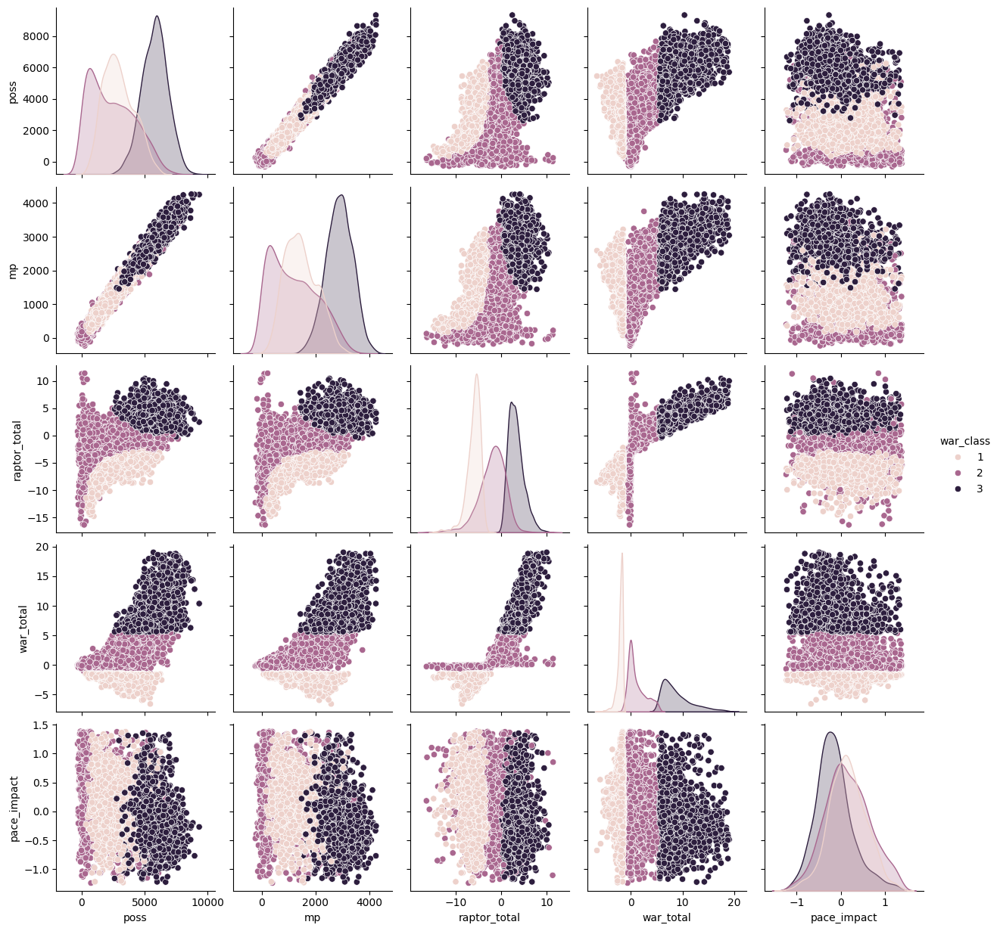

In [113]:
df_modif = boxplot_outlier_removal(df)

sn.pairplot(df_modif, hue='war_class')

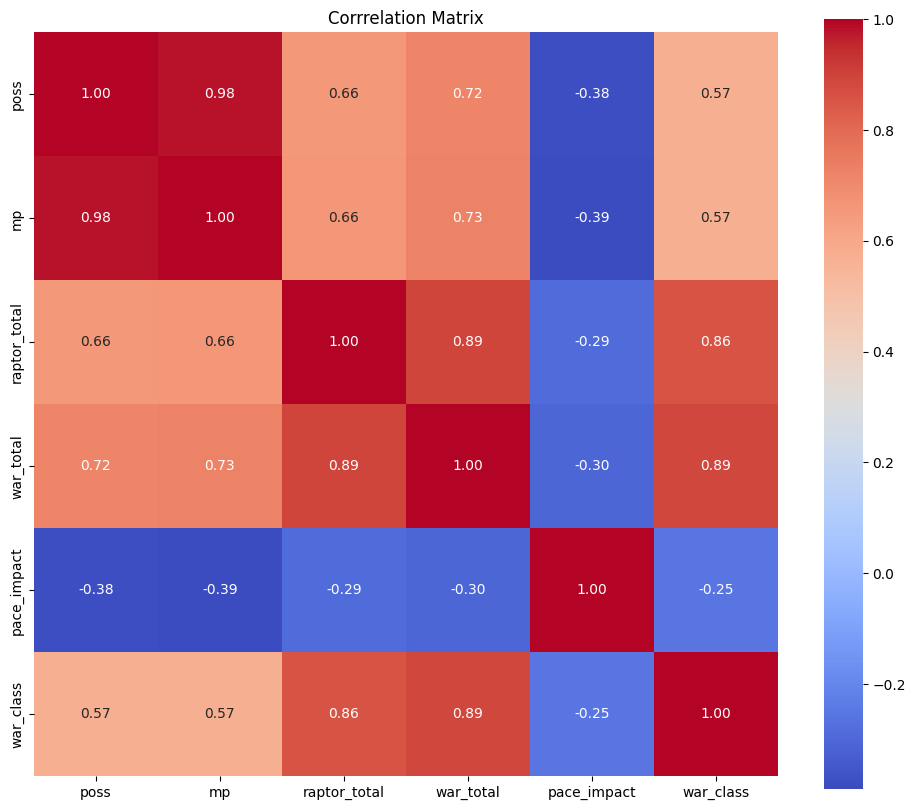

In [114]:
matrix = df_modif.corr()

plt.figure(figsize=(12,10))
sn.heatmap(matrix,annot=True, fmt=".2f",cmap='coolwarm',square=True)
plt.title('Corrrelation Matrix')
plt.show()

Tiro abajo la columna 'mp' por que tiene muy alta correlacion con poss, osea dan la misma informacion

In [115]:
count_dict = count_categories(df_modif,'war_class')

print("Category counts:")
for category, count in count_dict.items():
    print(f"Category {category}: {count} samples")


Category counts:
Category 1: 2007 samples
Category 2: 2338 samples
Category 3: 2144 samples


No hace falta resampling

In [116]:
df_reduced = df.drop(columns=['mp'])
df_reduced_2 = df_reduced.drop(columns=['raptor_total'])
df_train, df_val = train_val_split(df_reduced_2)

df_train_clean = boxplot_outlier_removal(df_train,exclude=['war_class'])
df_train_normalized, stats_train = normalize_columns(df_train_clean, exclude_cols=['war_class'])

df_val_clean = boxplot_outlier_removal(df_val,exclude=['war_class'])
df_val_normalized, stats_val = normalize_columns(df_val_clean,stats=stats_train, exclude_cols=['war_class'])

X_train = df_train_normalized.drop(columns=['war_class'])
y_train = df_train_normalized['war_class']

X_val = df_val_normalized.drop(columns=['war_class'])
y_val = df_val_normalized['war_class']

model_logistic = LogisticRegressionL2_multi()
model_logistic.fit(X_train, y_train)

model_LDA = LinearDiscriminantAnalysis()
model_LDA.fit(X_train, y_train)

model_forest = RandomForestClassifierCustom(n_estimators=2, max_depth=2)
model_forest.fit(X_train, y_train)


221 (4.07%) outliers removed
65 (4.79%) outliers removed


In [117]:
Y_pred_logi = model_logistic.predict(X_val)
Y_pred_prob_logi = model_logistic.predict_proba(X_val)

Y_pred_LDA = model_LDA.predict(X_val)
Y_pred_prob_LDA = model_LDA.predict_proba(X_val)

Y_pred_forest = model_forest.predict(X_val)
Y_pred_prob_forest = model_forest.predict_proba(X_val)

precision_logi = calculate_precision_multi(y_val, Y_pred_logi)
precision_LDA = calculate_precision_multi(y_val, Y_pred_LDA)
precision_forest = calculate_precision_multi(y_val, Y_pred_forest)

accuracy_logi = calculate_accuracy_multi(y_val, Y_pred_logi)
accuracy_LDA = calculate_accuracy_multi(y_val, Y_pred_LDA)
accuracy_forest = calculate_accuracy_multi(y_val, Y_pred_forest)

recall_logi = calculate_recall_multi(y_val, Y_pred_logi)
recall_LDA = calculate_recall_multi(y_val, Y_pred_LDA)
recall_forest = calculate_recall_multi(y_val, Y_pred_forest)

f_score_logi = calculate_fscore_multi(y_val, Y_pred_logi)
f_score_LDA = calculate_fscore_multi(y_val, Y_pred_LDA)
f_score_forest = calculate_fscore_multi(y_val, Y_pred_forest)

auc_PR_logi = calculate_auc_pr_multi(y_val, Y_pred_prob_logi)
auc_PR_LDA = calculate_auc_pr_multi(y_val, Y_pred_prob_LDA)
auc_PR_forest = calculate_auc_pr_multi(y_val, Y_pred_prob_forest)

auc_ROC_logi = calculate_auc_roc_multi(y_val, Y_pred_prob_logi)
auc_ROC_LDA = calculate_auc_roc_multi(y_val, Y_pred_prob_LDA)
auc_ROC_forest = calculate_auc_roc_multi(y_val, Y_pred_prob_forest)

precision_vals_logi, recall_vals_logi, thresh = calculate_precision_recall_curve_multi(y_val,Y_pred_prob_logi)
precision_vals_LDA, recall_vals_LDA, thresh = calculate_precision_recall_curve_multi(y_val,Y_pred_prob_LDA)
precision_vals_forest, recall_vals_forest, thresh = calculate_precision_recall_curve_multi(y_val,Y_pred_prob_forest)

fpr_vals_logi, tpr_vals_logi, thresh = calculate_roc_curve_multi(y_val,Y_pred_prob_logi)
fpr_vals_LDA, tpr_vals_LDA, thresh = calculate_roc_curve_multi(y_val,Y_pred_prob_LDA)
fpr_vals_forest, tpr_vals_forest, thresh = calculate_roc_curve_multi(y_val,Y_pred_prob_forest)

all_accuracys_2 = [accuracy_logi, accuracy_LDA, accuracy_forest]
all_precisions_2 = [precision_logi, precision_LDA, precision_forest]
all_recalls_2 = [recall_logi, recall_LDA, recall_forest]
all_f_scores_2 = [f_score_logi, f_score_LDA, f_score_forest]
all_auc_PRs_2 = [auc_PR_logi, auc_PR_LDA, auc_PR_forest]
all_auc_ROCs_2 = [auc_ROC_logi, auc_ROC_LDA, auc_ROC_forest]

all_metrics_2 = [all_accuracys_2, all_precisions_2, all_recalls_2, all_f_scores_2, all_auc_ROCs_2, all_auc_PRs_2]
print_results_table_from_lists_2(all_metrics_2)

| Modelo        | Accuracy | Precision | Recall | F-Score | AUC-ROC | AUC-PR |
|---------------|----------|-----------|--------|---------|---------|--------|
| Logistic      | 0.875    | 0.872     | 0.875  | 0.869   | 0.955   | 0.937  |
| LDA           | 0.725    | 0.717     | 0.725  | 0.702   | 0.882   | 0.763  |
| Random Forest | 1.000    | 1.000     | 1.000  | 1.000   | 1.000   | 0.998  |


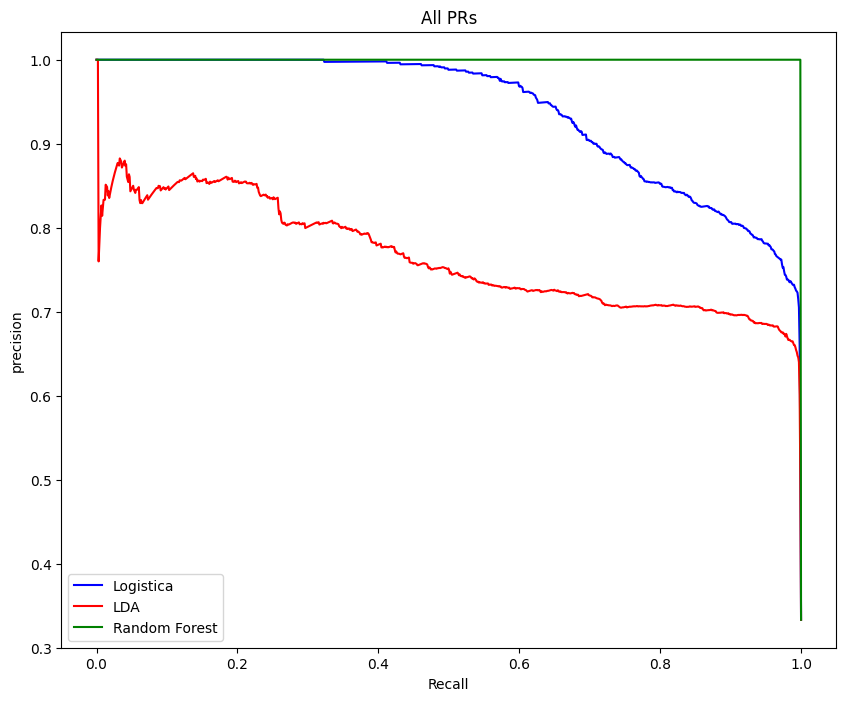

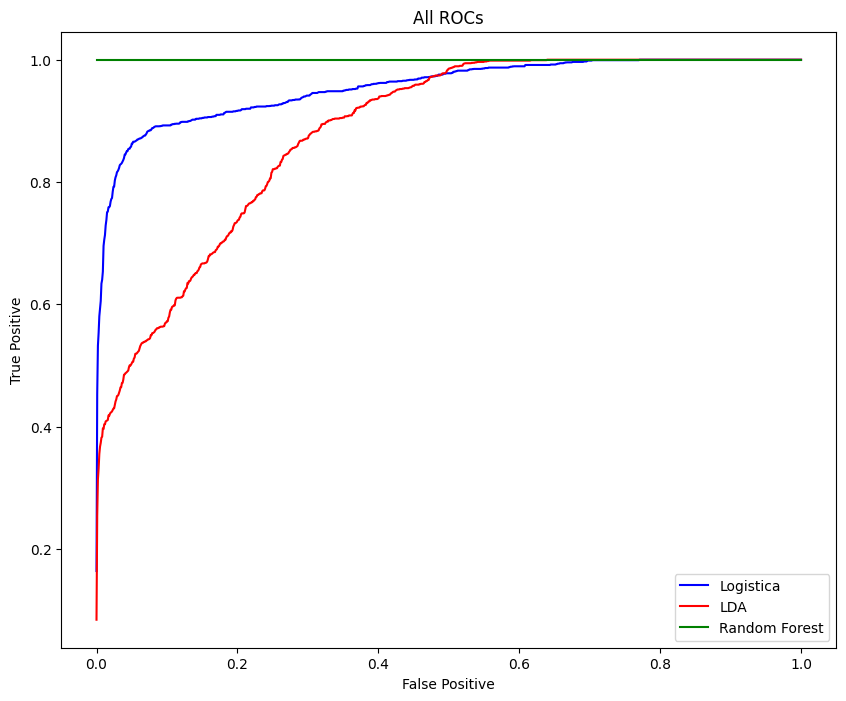

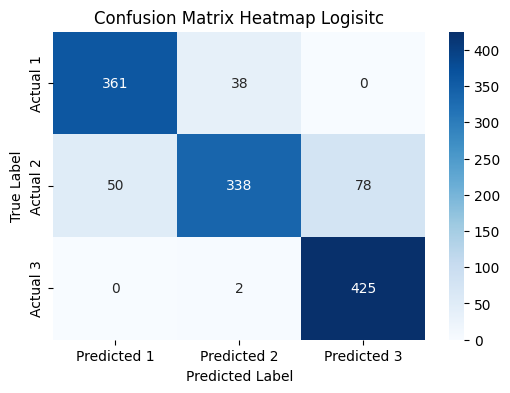

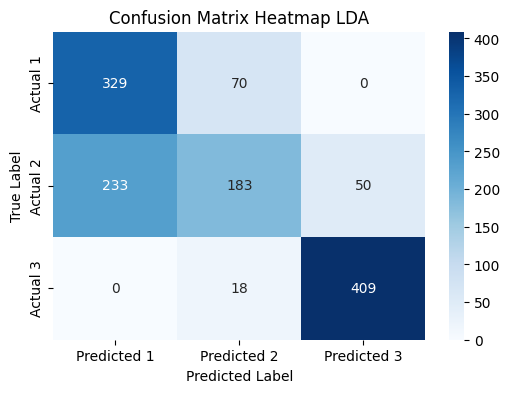

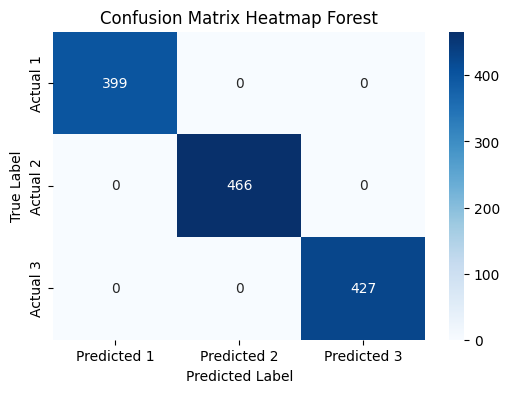

In [118]:
plt.figure(figsize=(10, 8))
plt.plot(recall_vals_logi, precision_vals_logi, label='Logistica', color='blue', )
plt.plot(recall_vals_LDA, precision_vals_LDA, label='LDA', color='red', )
plt.plot(recall_vals_forest, precision_vals_forest, label='Random Forest', color='green', )
plt.title('All PRs')
plt.xlabel('Recall')
plt.ylabel('precision')
plt.legend()
plt.show()

plt.figure(figsize=(10, 8))
plt.plot(fpr_vals_logi, tpr_vals_logi, label='Logistica', color='blue', )
plt.plot(fpr_vals_LDA, tpr_vals_LDA, label='LDA', color='red', )
plt.plot(fpr_vals_forest, tpr_vals_forest, label='Random Forest', color='green', )
plt.title('All ROCs')
plt.xlabel('False Positive')
plt.ylabel('True Positive')
plt.legend()
plt.show()

conf_matrix_imb_cost = calculate_confusion_matrix_multi(y_val,Y_pred_logi)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix_imb_cost, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 1', 'Predicted 2', 'Predicted 3'], 
            yticklabels=['Actual 1', 'Actual 2', 'Actual 3'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap Logisitc')

# Display the plot
plt.show()

conf_matrix_imb_cost = calculate_confusion_matrix_multi(y_val,Y_pred_LDA)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix_imb_cost, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 1', 'Predicted 2', 'Predicted 3'], 
            yticklabels=['Actual 1', 'Actual 2', 'Actual 3'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap LDA')

# Display the plot
plt.show()

conf_matrix_imb_cost = calculate_confusion_matrix_multi(y_val,Y_pred_forest)

plt.figure(figsize=(6, 4))  # Set figure size
sn.heatmap(conf_matrix_imb_cost, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Predicted 1', 'Predicted 2', 'Predicted 3'], 
            yticklabels=['Actual 1', 'Actual 2', 'Actual 3'])
    
# Add labels and title
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix Heatmap Forest')

# Display the plot
plt.show()

## Test

In [150]:
file_path = 'problema2/data/raw/WAR_class_dev.csv'
df_train = pd.read_csv(file_path)

file_path = 'problema2/data/raw/WAR_class_test.csv' 
df_test = pd.read_csv(file_path)

df_train_reduced = df_train.drop(columns=['mp'])
df_test_reduced = df_test.drop(columns=['mp'])
df_train_reduced_2 = df_train_reduced.drop(columns=['raptor_total'])
df_test_reduced_2 = df_test_reduced.drop(columns=['raptor_total'])

df_train_clean = boxplot_outlier_removal(df_train_reduced_2,exclude=['war_class'])
df_train_normalized, stats_train = normalize_columns(df_train_clean, exclude_cols=['war_class'])

df_test_clean = boxplot_outlier_removal(df_test_reduced_2,exclude=['war_class'])
df_test_normalized, stats_test = normalize_columns(df_test_clean,stats=stats_train, exclude_cols=['war_class'])

X_train = df_train_normalized.drop(columns=['war_class'])
Y_train = df_train_normalized['war_class']

X_test = df_test_normalized.drop(columns=['war_class'])
Y_test = df_test_normalized['war_class']

287 (4.23%) outliers removed
77 (4.54%) outliers removed


In [151]:
model_logistic = LogisticRegressionL2_multi()
model_logistic.fit(X_train, Y_train)

model_LDA = LinearDiscriminantAnalysis()
model_LDA.fit(X_train, Y_train)

model_forest = RandomForestClassifierCustom(n_estimators=3, max_depth=2)
model_forest.fit(X_train, Y_train)

| Modelo        | Accuracy | Precision | Recall | F-Score | AUC-ROC | AUC-PR |
|---------------|----------|-----------|--------|---------|---------|--------|
| Logistic      | 0.889    | 0.886     | 0.889  | 0.884   | 0.963   | 0.944  |
| LDA           | 0.742    | 0.736     | 0.742  | 0.725   | 0.901   | 0.787  |
| Random Forest | 0.970    | 0.973     | 0.970  | 0.971   | 0.995   | 0.985  |


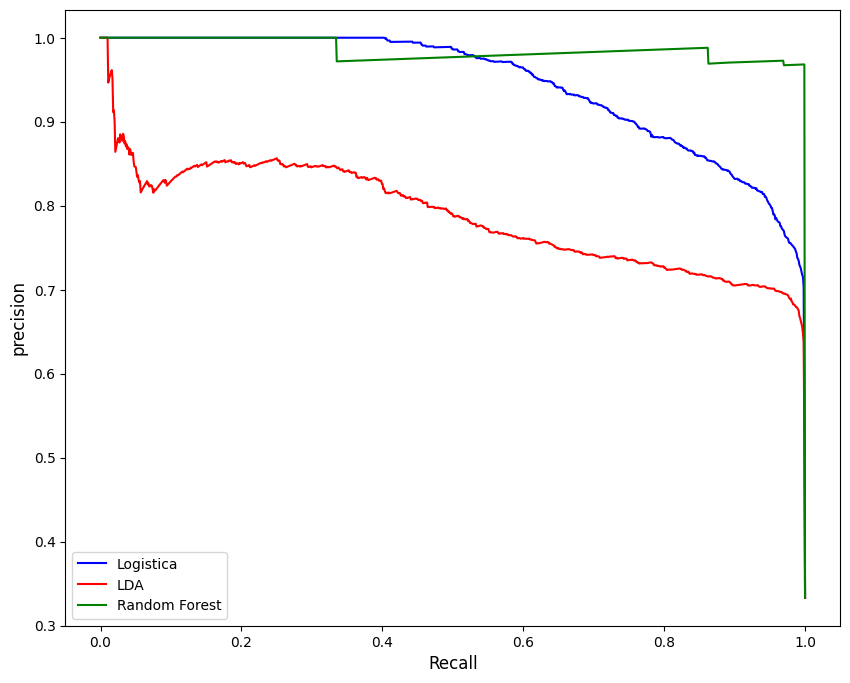

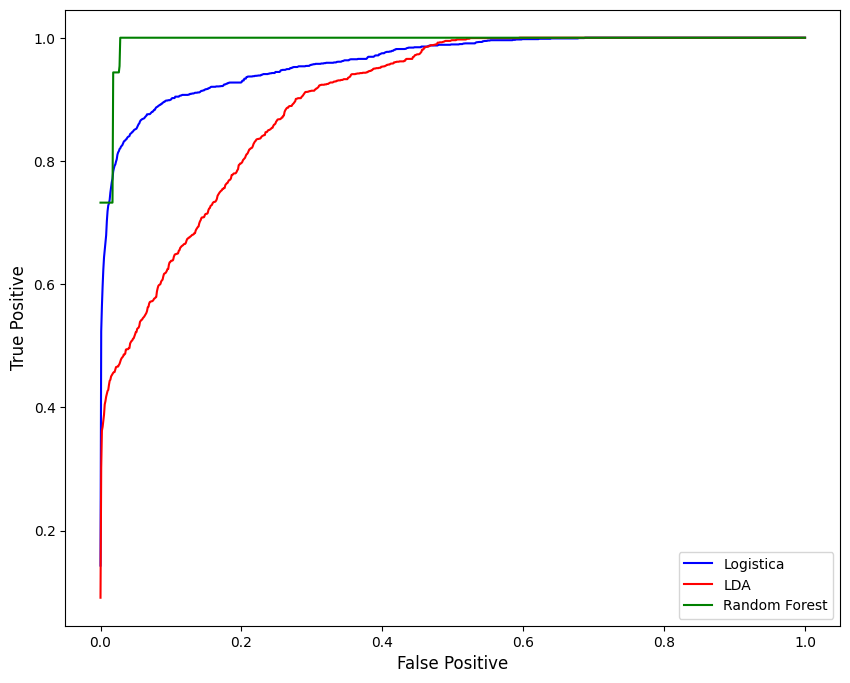

In [154]:
Y_pred_logi = model_logistic.predict(X_test)
Y_pred_prob_logi = model_logistic.predict_proba(X_test)

Y_pred_LDA = model_LDA.predict(X_test)
Y_pred_prob_LDA = model_LDA.predict_proba(X_test)

Y_pred_forest = model_forest.predict(X_test)
Y_pred_prob_forest = model_forest.predict_proba(X_test)

precision_logi = calculate_precision_multi(Y_test, Y_pred_logi)
precision_LDA = calculate_precision_multi(Y_test, Y_pred_LDA)
precision_forest = calculate_precision_multi(Y_test, Y_pred_forest)

accuracy_logi = calculate_accuracy_multi(Y_test, Y_pred_logi)
accuracy_LDA = calculate_accuracy_multi(Y_test, Y_pred_LDA)
accuracy_forest = calculate_accuracy_multi(Y_test, Y_pred_forest)

recall_logi = calculate_recall_multi(Y_test, Y_pred_logi)
recall_LDA = calculate_recall_multi(Y_test, Y_pred_LDA)
recall_forest = calculate_recall_multi(Y_test, Y_pred_forest)

f_score_logi = calculate_fscore_multi(Y_test, Y_pred_logi)
f_score_LDA = calculate_fscore_multi(Y_test, Y_pred_LDA)
f_score_forest = calculate_fscore_multi(Y_test, Y_pred_forest)

auc_PR_logi = calculate_auc_pr_multi(Y_test, Y_pred_prob_logi)
auc_PR_LDA = calculate_auc_pr_multi(Y_test, Y_pred_prob_LDA)
auc_PR_forest = calculate_auc_pr_multi(Y_test, Y_pred_prob_forest)

auc_ROC_logi = calculate_auc_roc_multi(Y_test, Y_pred_prob_logi)
auc_ROC_LDA = calculate_auc_roc_multi(Y_test, Y_pred_prob_LDA)
auc_ROC_forest = calculate_auc_roc_multi(Y_test, Y_pred_prob_forest)

precision_vals_logi, recall_vals_logi, thresh = calculate_precision_recall_curve_multi(Y_test,Y_pred_prob_logi)
precision_vals_LDA, recall_vals_LDA, thresh = calculate_precision_recall_curve_multi(Y_test,Y_pred_prob_LDA)
precision_vals_forest, recall_vals_forest, thresh = calculate_precision_recall_curve_multi(Y_test,Y_pred_prob_forest)

fpr_vals_logi, tpr_vals_logi, thresh = calculate_roc_curve_multi(Y_test,Y_pred_prob_logi)
fpr_vals_LDA, tpr_vals_LDA, thresh = calculate_roc_curve_multi(Y_test,Y_pred_prob_LDA)
fpr_vals_forest, tpr_vals_forest, thresh = calculate_roc_curve_multi(Y_test,Y_pred_prob_forest)

all_accuracys_2 = [accuracy_logi, accuracy_LDA, accuracy_forest]
all_precisions_2 = [precision_logi, precision_LDA, precision_forest]
all_recalls_2 = [recall_logi, recall_LDA, recall_forest]
all_f_scores_2 = [f_score_logi, f_score_LDA, f_score_forest]
all_auc_PRs_2 = [auc_PR_logi, auc_PR_LDA, auc_PR_forest]
all_auc_ROCs_2 = [auc_ROC_logi, auc_ROC_LDA, auc_ROC_forest]

all_metrics_2 = [all_accuracys_2, all_precisions_2, all_recalls_2, all_f_scores_2, all_auc_ROCs_2, all_auc_PRs_2]
print_results_table_from_lists_2(all_metrics_2)

plt.figure(figsize=(10, 8))
plt.plot(recall_vals_logi, precision_vals_logi, label='Logistica', color='blue', )
plt.plot(recall_vals_LDA, precision_vals_LDA, label='LDA', color='red', )
plt.plot(recall_vals_forest, precision_vals_forest, label='Random Forest', color='green', )
# plt.title('All PRs')
plt.xlabel('Recall',fontsize=12)
plt.ylabel('precision',fontsize=12)
plt.legend()
plt.show()

plt.figure(figsize=(10, 8))
plt.plot(fpr_vals_logi, tpr_vals_logi, label='Logistica', color='blue', )
plt.plot(fpr_vals_LDA, tpr_vals_LDA, label='LDA', color='red', )
plt.plot(fpr_vals_forest, tpr_vals_forest, label='Random Forest', color='green', )
# plt.title('All ROCs')
plt.xlabel('False Positive',fontsize=12)
plt.ylabel('True Positive',fontsize=12)
plt.legend()
plt.show()